Logbook:
https://docs.google.com/document/d/10F1qXnhcWOobazE5PRGmF3VUbtTOQDvJnlBE9xEdjEs/edit

# imports

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from glob import glob
from os.path import basename, exists
from tiffile import imread
import laserbeamsize as lbs
import matplotlib as mpl
import re
import xarray as xr
import h5py
import dask.array as da
import dask.dataframe as dd
from nexus import NexusReader
mpl.rcParams['font.size'] = 20

# load data

In [6]:
ds = xr.open_dataset(r'G:\Shared drives\code\projects\pcmo\data\225.0K.h5')

KeyError: 'Unable to open object (bad object header version number)'

In [1]:
import dask.array as da
from dask.distributed import Client, progress

client = Client(n_workers=4)
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 12,Total memory: 15.84 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:56316,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 12
Started: Just now,Total memory: 15.84 GiB
Comm: tcp://127.0.0.1:56338,Total threads: 3
Dashboard: http://127.0.0.1:56345/status,Memory: 3.96 GiB
Nanny: tcp://127.0.0.1:56319,


In [19]:
img = imread(files[fi], key=0)

In [5]:
fi = 0
temp = temps[fi]

store = imread(files[fi], aszarr=True)
data = da.from_zarr(store)

In [24]:
data

dask.array<from-zarr, shape=(2048, 1340, 1300), dtype=float32, chunksize=(1, 4, 1300), chunktype=numpy.ndarray>

In [25]:

data.to_zarr(outfile)

2024-01-17 16:52:17,445 - distributed.protocol.pickle - ERROR - Failed to serialize <ToPickle: HighLevelGraph with 1 layers.
 0. 1545096630336
>.
Traceback (most recent call last):
  File "C:\Users\rtumbleson\anaconda3\envs\general\Lib\site-packages\distributed\protocol\pickle.py", line 63, in dumps
    result = pickle.dumps(x, **dump_kwargs)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
TypeError: cannot pickle '_thread.RLock' object

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\rtumbleson\anaconda3\envs\general\Lib\site-packages\distributed\protocol\pickle.py", line 68, in dumps
    pickler.dump(x)
TypeError: cannot pickle '_thread.RLock' object

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\rtumbleson\anaconda3\envs\general\Lib\site-packages\distributed\protocol\pickle.py", line 81, in dumps
    result = cloudpickle.dumps(x, **dump_kwar

TypeError: ('Could not serialize object of type HighLevelGraph', '<ToPickle: HighLevelGraph with 1 layers.\n<dask.highlevelgraph.HighLevelGraph object at 0x167ef951190>\n 0. 1545096630336\n>')

In [7]:
img = data[0]
img

dask.array<getitem, shape=(1340, 1300), dtype=float32, chunksize=(4, 1300), chunktype=numpy.ndarray>

In [21]:
import dask.array as da
x = da(img)
x

TypeError: 'module' object is not callable

In [ ]:
y = x + x.T
z = y[::2, 5000:].mean(axis=1)
z

dask.array<mean_agg-aggregate, shape=(5000,), dtype=float64, chunksize=(500,), chunktype=numpy.ndarray>

In [ ]:
z.compute()

array([1.00242963, 0.98492999, 1.0026447 , ..., 0.99913407, 0.996942  ,
       1.00851582])

In [22]:
tmp = xr.DataArray(
    img,
    dims=('row', 'col'),
    coords={'test':'test'},
)

In [23]:
tmp

<xarray.DataArray (row: 1340, col: 1300)>
array([[  -3.,    8.,    5., ..., -278., -253., -236.],
       [ -16.,  -15.,  -39., ..., -284., -286., -304.],
       [  13.,  -11.,   14., ..., -300., -267., -307.],
       ...,
       [ -20.,   43.,   31., ..., -307., -325., -296.],
       [   4.,  -21.,   10., ..., -346., -329., -330.],
       [  13.,   21.,   38., ..., -316., -270., -356.]], dtype=float32)
Coordinates:
    test     <U4 'test'
Dimensions without coordinates: row, col

2024-01-17 16:25:03,031 - distributed.protocol.pickle - ERROR - Failed to serialize <ToPickle: HighLevelGraph with 1 layers.
 0. 1544297882240
>.
Traceback (most recent call last):
  File "C:\Users\rtumbleson\anaconda3\envs\general\Lib\site-packages\distributed\protocol\pickle.py", line 63, in dumps
    result = pickle.dumps(x, **dump_kwargs)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
TypeError: cannot pickle '_thread.RLock' object

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\rtumbleson\anaconda3\envs\general\Lib\site-packages\distributed\protocol\pickle.py", line 68, in dumps
    pickler.dump(x)
TypeError: cannot pickle '_thread.RLock' object

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\rtumbleson\anaconda3\envs\general\Lib\site-packages\distributed\protocol\pickle.py", line 81, in dumps
    result = cloudpickle.dumps(x, **dump_kwar

TypeError: ('Could not serialize object of type HighLevelGraph', '<ToPickle: HighLevelGraph with 1 layers.\n<dask.highlevelgraph.HighLevelGraph object at 0x1678f60d210>\n 0. 1544297882240\n>')

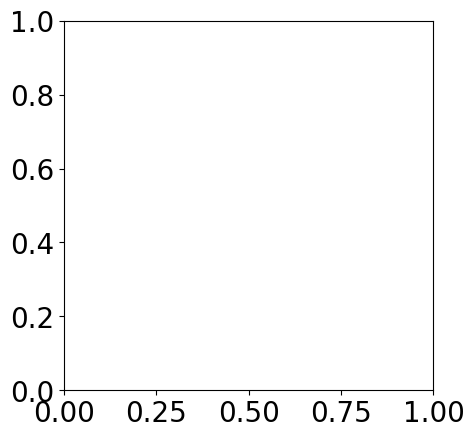

In [8]:
plt.imshow(img)

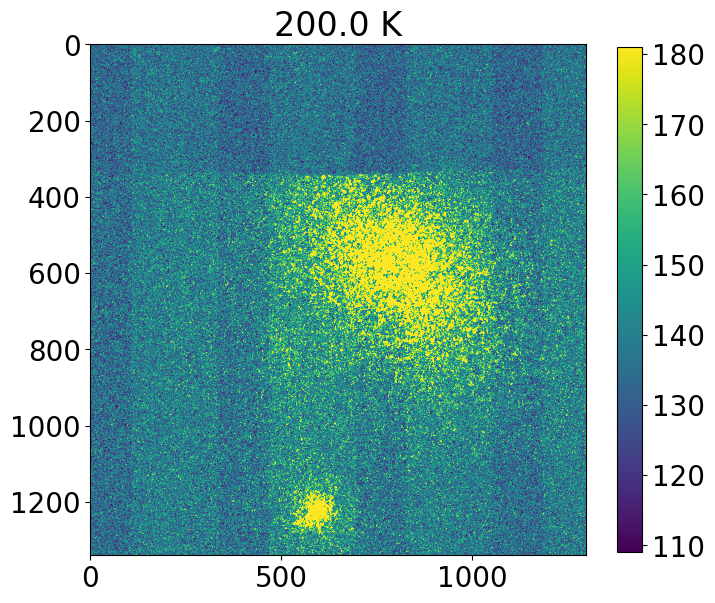

In [20]:
vmin = np.percentile(img, 10)
vmax = np.percentile(img, 90)

plt.figure(figsize=(8,8))
plt.title(f'{temp} K')
plt.imshow(img, vmin=vmin, vmax=vmax)
plt.colorbar(shrink=0.82)
plt.show()

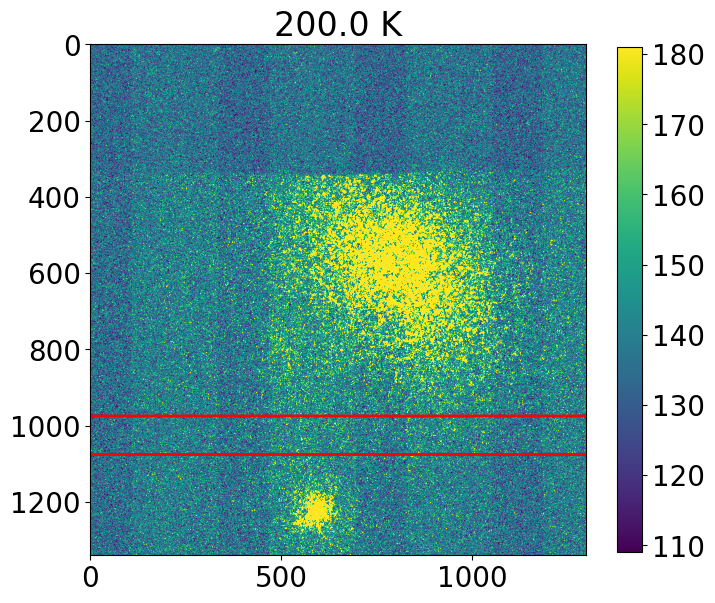

In [25]:
roi = np.s_[975:1075, ...]
overlay = np.zeros_like(img)
overlay[roi] = 1

plt.figure(figsize=(8,8))
plt.title(f'{temp} K')
plt.imshow(img, vmin=vmin, vmax=vmax)
plt.colorbar(shrink=0.82)
plt.contour(overlay, colors=['r'])
plt.show()

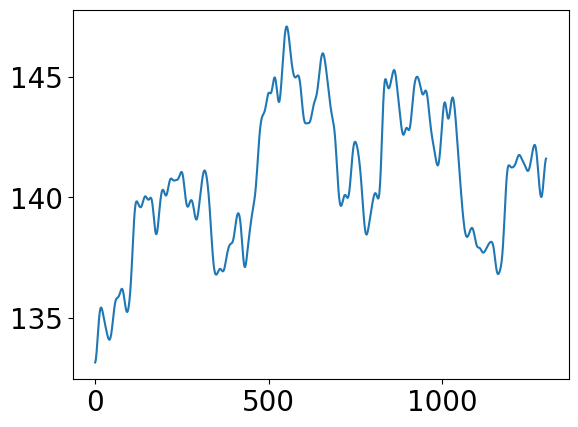

In [26]:
from scipy.ndimage import gaussian_filter1d

gline = gaussian_filter1d(img[roi].mean(axis=0), sigma=7)
gline1 = gaussian_filter1d(gline, sigma=3)
plt.plot(gline)

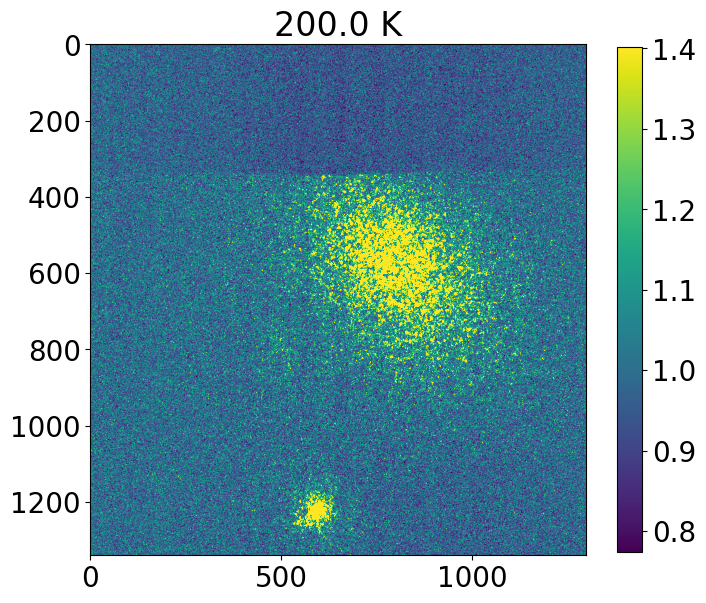

In [31]:
gimg = img / np.expand_dims(gline, axis=0)

vmin = np.percentile(gimg, 10)
vmax = np.percentile(gimg, 95)

plt.figure(figsize=(8,8))
plt.title(f'{temp} K')
plt.imshow(gimg, vmin=vmin, vmax=vmax)
plt.colorbar(shrink=0.82)
#plt.contour(overlay, colors=['r'])
plt.show()

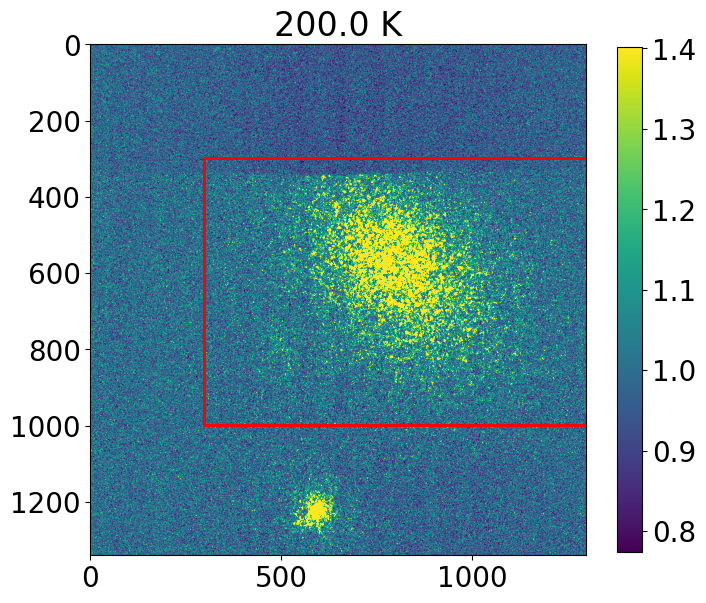

In [36]:
roi = np.s_[300:1000, 300:]
overlay = np.zeros_like(img)
overlay[roi] = 1

vmin = np.percentile(gimg, 10)
vmax = np.percentile(gimg, 95)

plt.figure(figsize=(8,8))
plt.title(f'{temp} K')
plt.imshow(gimg, vmin=vmin, vmax=vmax)
plt.colorbar(shrink=0.82)
plt.contour(overlay, colors=['r'])
plt.show()

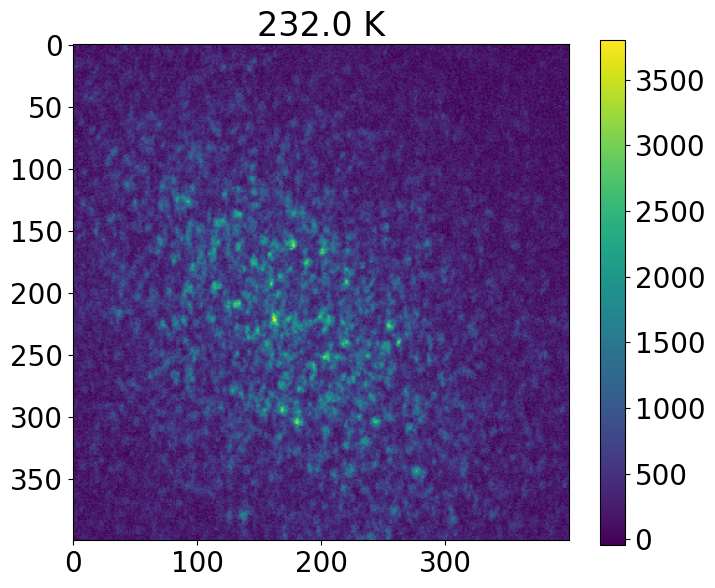

In [11]:
roi = np.s_[280:680,600:1000]

vmin = np.percentile(img, 10)
vmax = np.percentile(img, 100)


plt.figure(figsize=(8,8))
plt.title(f'{temp} K')
plt.imshow(img[roi], vmin=vmin, vmax=vmax)
plt.colorbar(shrink=0.82)
plt.show()

In [5]:
store = tifffile.imread(files[fi], aszarr=True)
z = zarr.open(store, mode='r')

In [8]:
roi = np.s_[280:680,600:1000]
data = np.empty(shape=(z.shape[0], roi[0].stop-roi[0].start, roi[1].stop-roi[1].start))
for i in tqdm(range(z.shape[0]), total=z.shape[0]):
    img = io.imread(files[fi], img_num=i)[120:, :]
    data[i] = remove_noise(img)[roi]

  0%|          | 0/1817 [00:00<?, ?it/s]

In [9]:
data.shape

(1817, 400, 400)

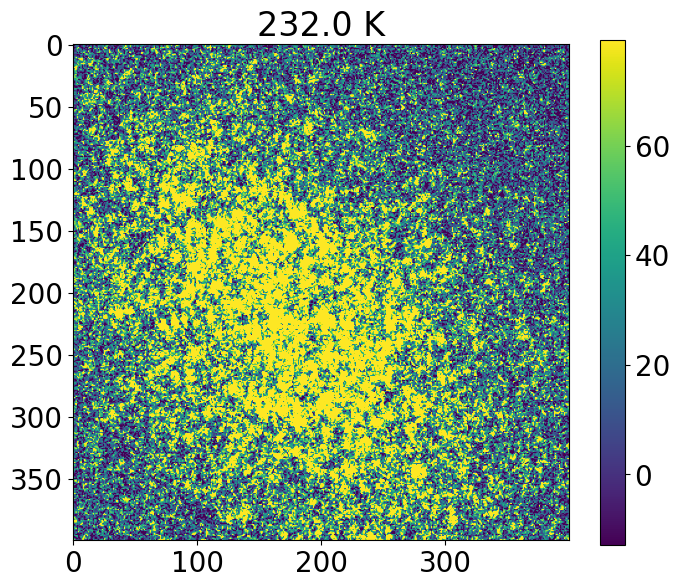

In [10]:
img = data[1]

vmin = np.percentile(img, 10)
vmax = np.percentile(img, 80)

plt.figure(figsize=(8,8))
plt.title(f'{temp} K')
plt.imshow(img, vmin=vmin, vmax=vmax)
plt.colorbar(shrink=0.82)
plt.show()

  0%|          | 0/160000 [00:00<?, ?it/s]

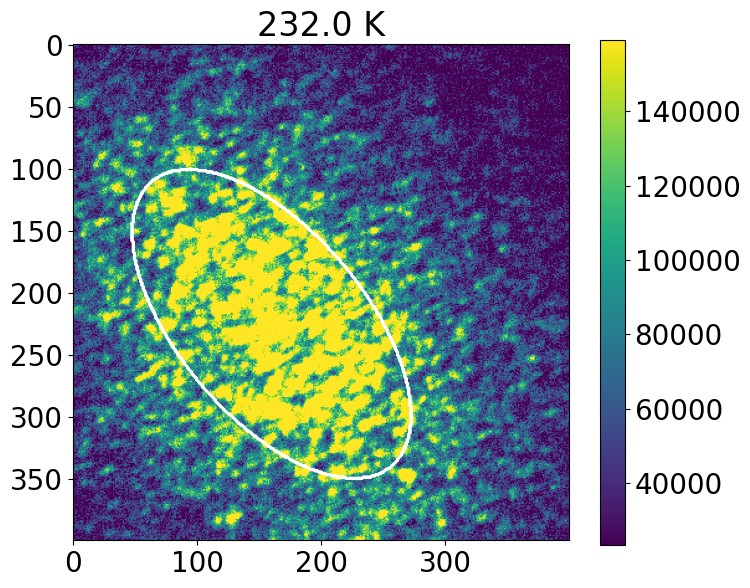

In [11]:
# Create label array
x0 = 160
y0 = 225
width = 300
height = 150
orientation = 0.7

img = np.sum(data, axis=0)
ell = Ellipse((y0,x0), width=width, height=height, angle=np.rad2deg(orientation))
ellipsepoints = np.vstack([p for p in tqdm(np.ndindex(img.shape), total=len(img.ravel())) if ell.contains_point(p, radius=0)])

label_array = np.zeros_like(img)
label_array[ellipsepoints[:,0], ellipsepoints[:,1]] = 1
    
vmin = np.percentile(img, 10)
vmax = np.percentile(img, 90)


plt.figure(figsize=(8,8))
plt.title(f'{temp} K')
plt.imshow(img, vmin=vmin, vmax=vmax)
plt.colorbar(shrink=0.82)
plt.contour(label_array, colors='w')
plt.show()

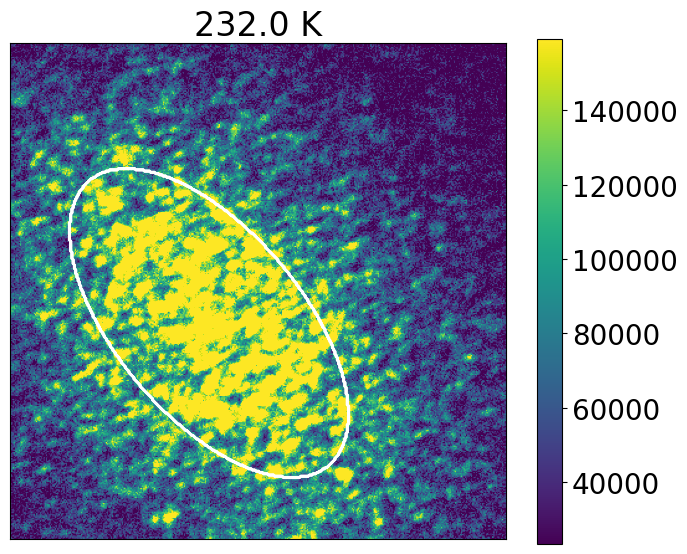

In [12]:
plt.figure(figsize=(8,8))
plt.title(f'{temp} K')
plt.imshow(img, vmin=vmin, vmax=vmax)
plt.colorbar(shrink=0.82)
plt.contour(label_array, colors='w')
plt.xticks([])
plt.yticks([])
plt.show()

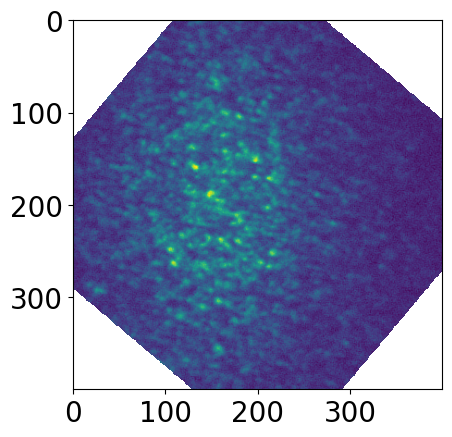

In [24]:
from scipy.ndimage import rotate

rimg = rotate(img, -np.rad2deg(orientation), reshape=False, cval=np.nan)
plt.imshow(rimg)

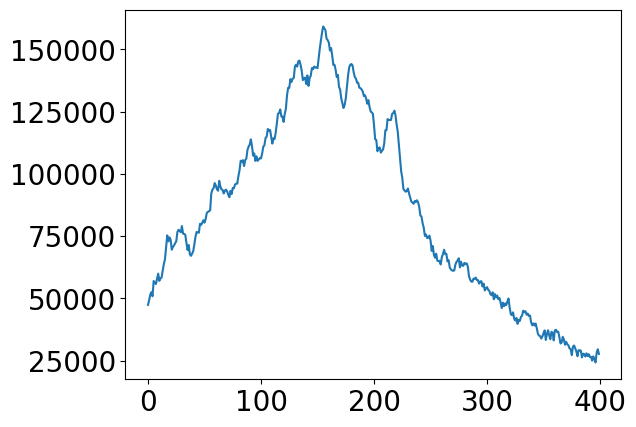

In [26]:
plt.plot(np.nanmean(rimg, axis=0))

In [13]:
bbox = bounding_box(np.where(label_array!=0))

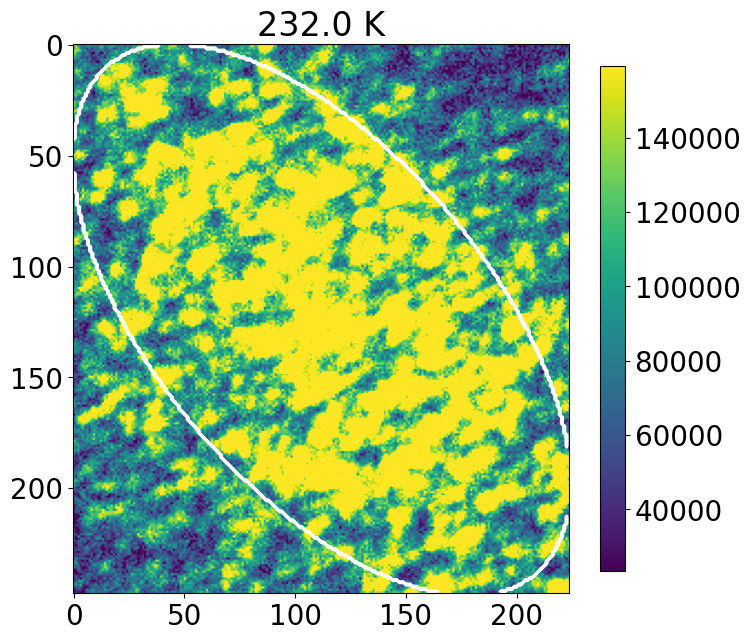

In [19]:
vmin = np.percentile(img, 10)
vmax = np.percentile(img, 90)

plt.figure(figsize=(8,8))
plt.title(f'{temp} K')
plt.imshow(img[bbox], vmin=vmin, vmax=vmax)
plt.colorbar(shrink=0.82)
plt.contour(label_array[bbox], colors='w')
plt.show()

In [20]:
smd = data[(...,*bbox)]*label_array[bbox]
I0 = np.sum(smd, axis=(1,2))

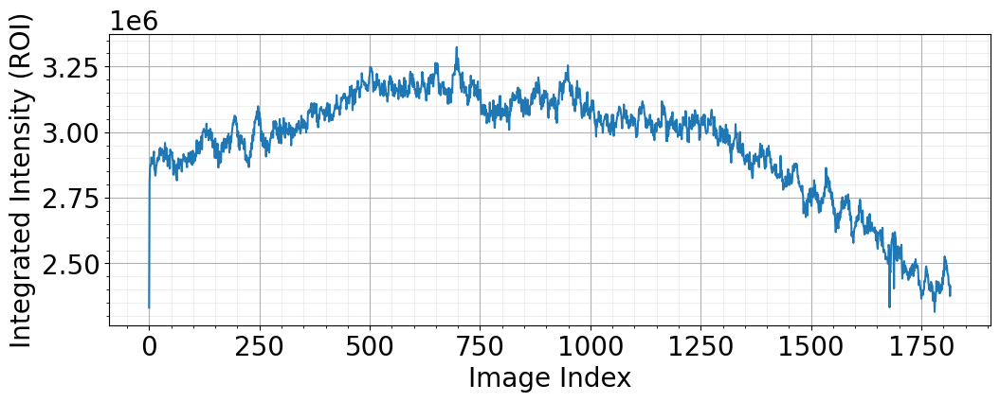

In [21]:
fig, ax = plt.subplots(figsize=(12,4))
plt.plot(I0)
plt.ylabel('Integrated Intensity (ROI)')
plt.xlabel('Image Index')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)

#plt.axvline(20, c='r')
#plt.axvline(2300, c='r')
plt.show()

In [22]:
smd = smd[1:]
I0 = I0[1:]

# stats stuff

In [80]:
mask = label_array[bbox].copy()
mask[mask==0] = np.nan

s = smd.copy()
s *= mask

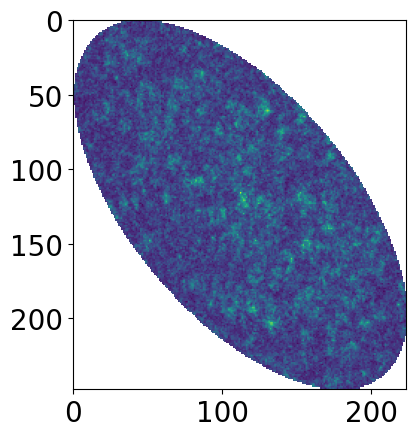

In [81]:
plt.imshow(s[0])

In [82]:
s.shape

(1816, 248, 224)

In [83]:
s = s.reshape((s.shape[0], -1))
s = s[~np.isnan(s)]
s = s.reshape((1816, -1))

In [85]:
s.shape

(1816, 35304)

In [86]:
var = np.var(s, axis=0)
nvar = var / np.nanmean(var)

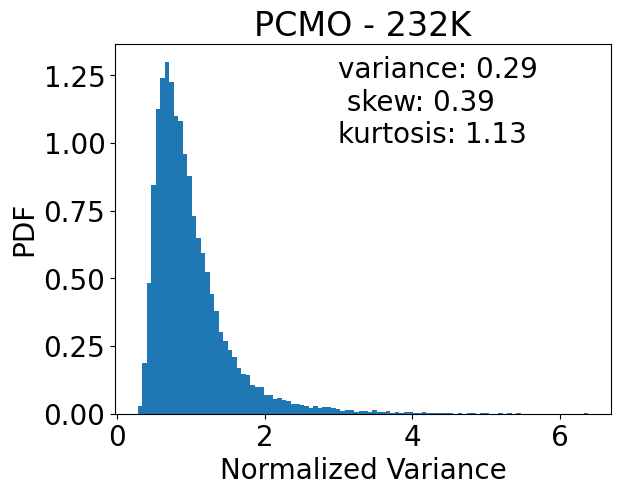

In [108]:
plt.figure()
plt.hist(nvar, bins=100, density=True)
plt.title('PCMO - 232K')
plt.xlabel('Normalized Variance')
plt.ylabel('PDF')
plt.text(3, 1, f'variance: {moment(nvar, 2):.2f}\n skew: {moment(nvar, 3):.2f}\nkurtosis: {moment(nvar, 4):.2f}')
plt.show()

In [104]:
from scipy.stats import moment

moment(nvar, 2)
moment(nvar, 3)

0.38809020590751203

In [77]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(s)
snorm = scaler.transform(s)

In [78]:
nvar = np.var(snorm, axis=0)

(array([5.0000e+00, 5.8000e+01, 6.0800e+02, 3.4330e+03, 9.7550e+03,
        1.1461e+04, 7.2730e+03, 2.3950e+03, 2.7300e+02, 4.3000e+01]),
 array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]),
 <BarContainer object of 10 artists>)

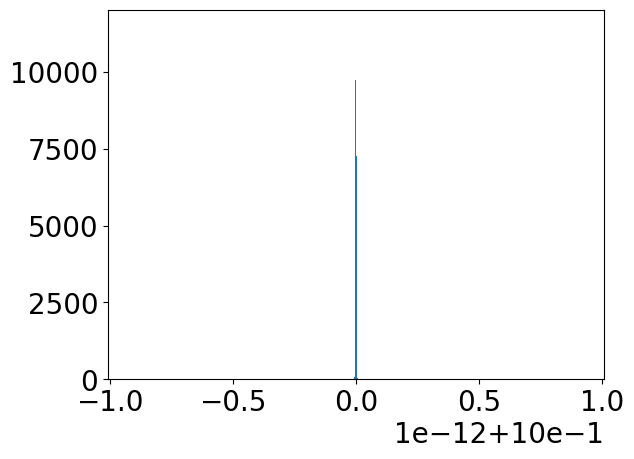

In [79]:
plt.hist(nvar)

# end of stats stuff

# Calculate g2

In [27]:
smd.shape

NameError: name 'smd' is not defined

In [23]:
for i, s in tqdm(enumerate(smd), total=len(smd)):
    smd[i] = s/I0[i]

  0%|          | 0/1816 [00:00<?, ?it/s]

In [94]:
# calculate g2
num_levels = 1
num_bufs = int(len(smd) / 2) * 2
corr_gen = corr.lazy_one_time(smd, num_levels, num_bufs, label_array[bbox].astype(int))

for result in tqdm(corr_gen, total=len(smd)):
    pass
g2, lag_steps = result.g2, result.lag_steps

  0%|          | 0/1816 [00:00<?, ?it/s]


KeyboardInterrupt



In [276]:
temp

232.0

In [277]:
t = lag_steps*(1.815+2)

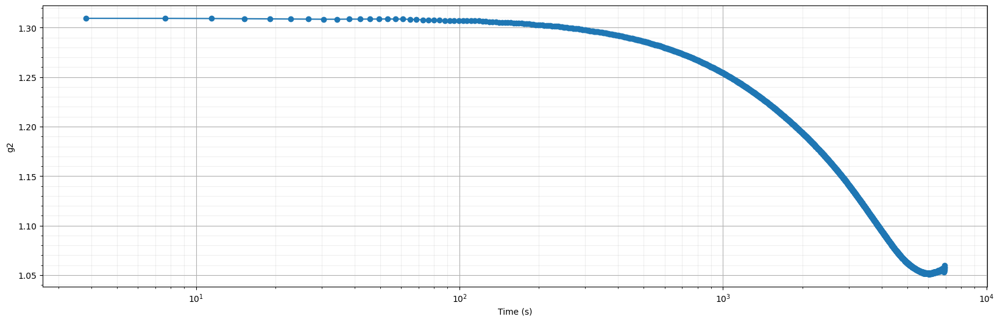

In [278]:
plt.figure(figsize=(20,6))
plt.semilogx(t[1:], g2[1:], '-o')
plt.xlabel('Time (s)')
plt.ylabel('g2')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.show()

# Calculate two-time

In [22]:
num_levels = 1
num_bufs = int(len(smd) / 2) * 2
num_frames = num_bufs
gen = corr.lazy_two_time(label_array[bbox].astype(int), smd[:num_frames], num_frames, num_bufs, num_levels)
for result in tqdm(gen, total=len(smd)):
    pass
out = corr.two_time_state_to_results(result)
g2_2t, lag_steps_2t = out.g2, out.lag_steps

  0%|          | 0/1817 [00:00<?, ?it/s]

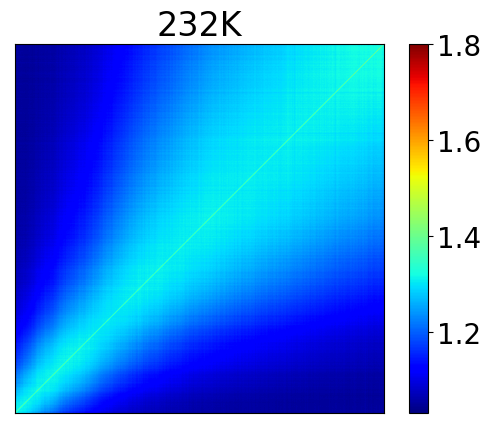

In [23]:
plt.title('232K')
plt.imshow(np.squeeze(g2_2t)[120:, 120:],
          origin='lower', cmap='jet')
plt.xticks([])
plt.yticks([])
plt.colorbar()

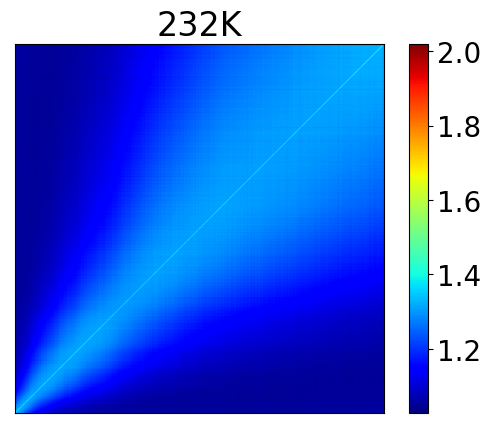

In [52]:
plt.title('232K')
plt.imshow(g,
          origin='lower', cmap='jet')
plt.xticks([])
plt.yticks([])
plt.colorbar()

In [48]:
test = np.zeros_like(g)

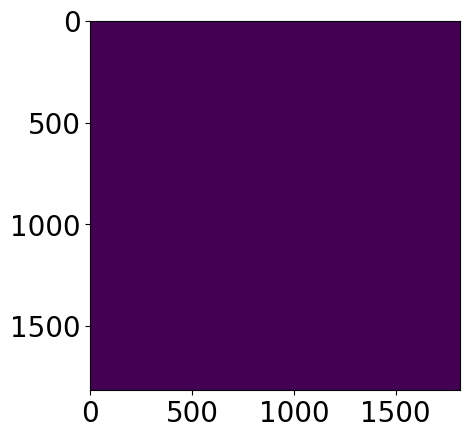

In [49]:
plt.imshow(test)

In [76]:
test = np.zeros_like(g)
start = 1000
for i in range(len(g) - start):
    test[start-i,start+i] = 1

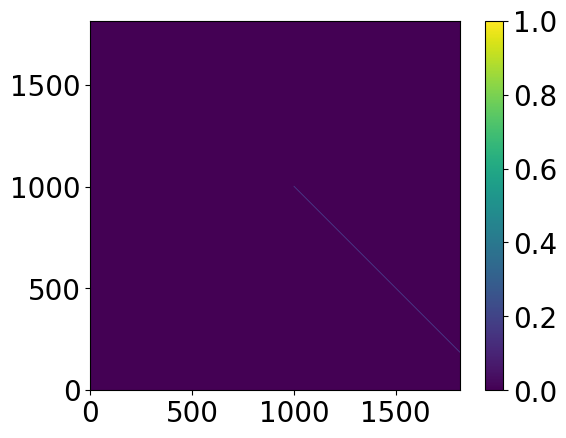

In [77]:
plt.imshow(test, origin='lower')
plt.colorbar()

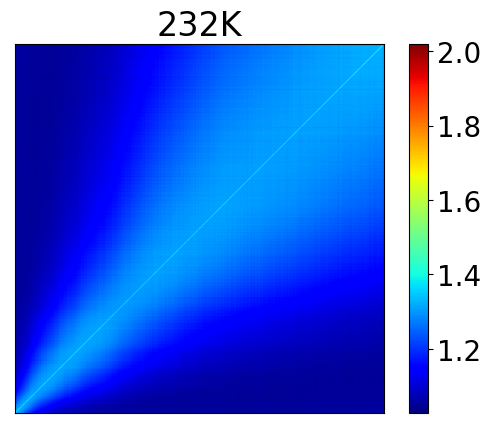

In [90]:
plt.title('232K')
plt.imshow(g,
          origin='lower', cmap='jet')
plt.xticks([])
plt.yticks([])
plt.colorbar()

In [106]:
gg = g.copy()
for start in [200, 500, 1000, 1500]:
    for i in range(min((start, len(g) - start))):
        gg[start-i,start+i] = 10

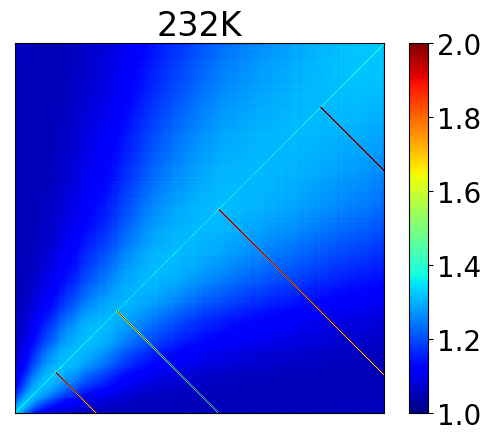

In [107]:
plt.title('232K')
plt.imshow(gg, vmin=1, vmax=2,
          origin='lower', cmap='jet')
plt.xticks([])
plt.yticks([])
plt.colorbar()

In [125]:
g.shape

(1816, 1816)

In [129]:
t = np.arange(1816-1)*3.815

In [150]:
len(t[t<4500])

1180

In [151]:
diag = []
cuts = [236, 472, 708, 944, 1180]
for start in cuts:
    d = np.array([g[start-i-1, start+i] for i in range(min((start, len(g) - start)))])[1:]
    diag.append(d)

In [152]:
gg = g.copy()
for start in cuts:
    for i in range(min((start, len(g) - start))):
        gg[start-i,start+i] = 10

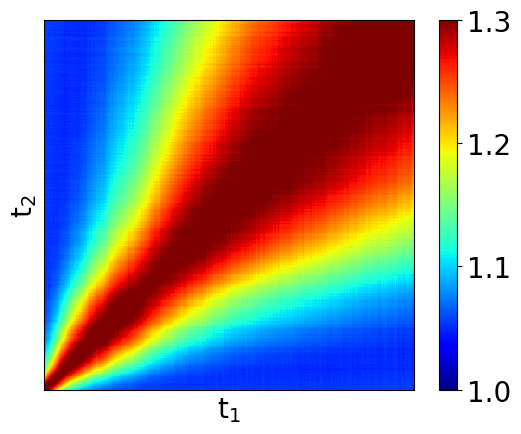

In [159]:
#plt.title('232K')
plt.imshow(g, vmin=1, vmax=1.3,
          origin='lower', cmap='jet')
plt.xticks([])
plt.yticks([])
plt.ylabel(r't$_2$')
plt.xlabel(r't$_1$')
plt.colorbar()
plt.show()

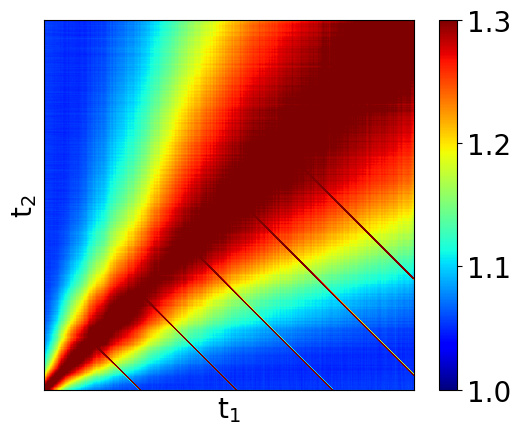

In [158]:
#plt.title('232K')
plt.imshow(gg, vmin=1, vmax=1.3,
          origin='lower', cmap='jet')
plt.xticks([])
plt.yticks([])
plt.ylabel(r't$_2$')
plt.xlabel(r't$_1$')
plt.colorbar()
plt.show()

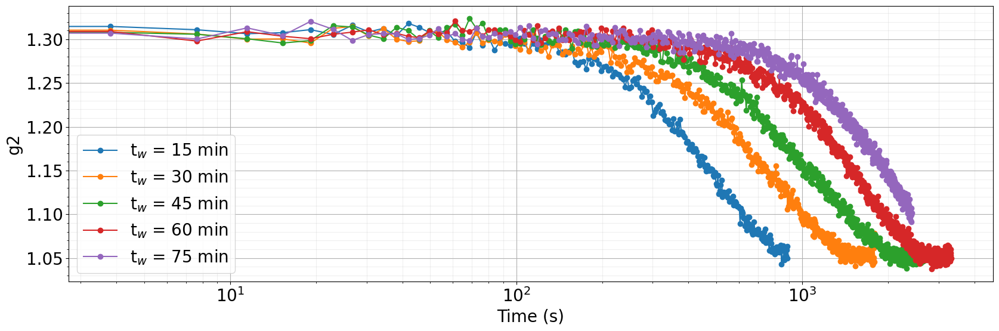

In [154]:
g = np.squeeze(g2_2t)
plt.figure(figsize=(20,6))

for d, s in zip(diag, cuts):
    plt.semilogx(np.arange(len(d)-1)*3.815, d[1:], '-o', label=rf't$_w$ = {s*3.815/60:.0f} min')
    
plt.xlabel('Time (s)')
plt.ylabel('g2')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.legend()
plt.show()

## save

In [281]:
save_dict = {temp:
             {'g2': np.squeeze(g2),
            't': t,
            'two_time': np.squeeze(g2_2t),
            'integrated_image': img,
            'label_array': label_array,
            'I0': I0
            }
            }

In [282]:
df = pd.DataFrame(save_dict)

In [283]:
df.head()

,232.0
I0,"[2807824.0790686607, 2860997.395802498, 287575..."
g2,"[1.6679695561276866, 1.3093275431007174, 1.309..."
integrated_image,"[[65718.35486984253, 44847.516795158386, 25951..."
label_array,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
t,"[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8..."


In [284]:
df.to_pickle(rf'G:/Shared drives/code/out/pcmo/pcmo_3-23-2023/tmp_{temp}_3-23-2023.pkl')

In [ ]:
df_arr = []
for f in glob(rf'G:/Shared drives/code/out/pcmo/pcmo_3-23-2023/*'):
    df_arr.append(pd.read_pickle(f))

df = pd.concat(df_arr, axis=1)

In [335]:
df

,200.0,225.0,230.0,230.5,231.0,231.1,231.5,232.0
I0,"[3924074.5, 5675856.0, 5671510.5, 5719870.0, 5...","[3436363.7561540604, 3625005.777390003, 388993...","[6596746.483584166, 6573964.37879324, 6542131....","[3829644.7268309593, 3839438.74177742, 3840476...","[1851387.1065443754, 1849650.1932754517, 18672...","[1804151.4403164387, 1820951.8153731823, 17832...","[2956280.0248761177, 2946470.594007015, 297166...","[2807824.0790686607, 2860997.395802498, 287575..."
g2,"[2.244013122776648, 1.5574586923595717, 1.5575...","[1.9199913861887374, 1.369571172635046, 1.3695...","[1.8984451944312113, 1.4163879078394195, 1.416...","[2.040900499375456, 1.453415404792756, 1.45330...","[2.0537401321341813, 1.3922161649837475, 1.392...","[2.216482396290602, 1.3951367314132774, 1.3952...","[1.7744139933320238, 1.3365103287597728, 1.336...","[1.6679695561276866, 1.3093275431007174, 1.309..."
integrated_image,"[[-22026.025, -20226.578, -8356.113, 12845.396...","[[57822.01762664318, 55705.651694357395, 24963...","[[31704.166274368763, 37104.23644399643, 32896...","[[14708.630834106356, 17510.742964223027, 3598...","[[46993.372248232365, -9222.360726714134, -987...","[[-21909.132342219353, 5848.169311136007, -517...","[[17892.246096409857, 20469.520103096962, 3865...","[[65718.35486984253, 44847.516795158386, 25951..."
label_array,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
t,"[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8..."
two_time,"[[3.4693991117019767, 1.7327323313344998, 1.73...","[[2.0650266709729936, 1.42115699499544, 1.4193...","[[1.66259414799164, 1.3837018287338874, 1.3765...","[[2.004645608849578, 1.4544635095248588, 1.448...","[[2.2618299999927087, 1.4407108798223947, 1.42...","[[2.2574186084712347, 1.3870326943202504, 1.38...","[[1.802646100003165, 1.3554412217187786, 1.351...","[[1.6859403164902422, 1.3218637063014758, 1.31..."


In [4]:
df = pd.read_pickle(rf'G:/Shared drives/code/out/pcmo/pcmo_3-23-2023/combined_3-23-2023.pkl')

In [5]:
df.head()

,200.0,225.0,230.0,230.5,231.0,231.1,231.5,232.0
I0,"[3924074.5, 5675856.0, 5671510.5, 5719870.0, 5...","[3436363.7561540604, 3625005.777390003, 388993...","[6596746.483584166, 6573964.37879324, 6542131....","[3829644.7268309593, 3839438.74177742, 3840476...","[1851387.1065443754, 1849650.1932754517, 18672...","[1804151.4403164387, 1820951.8153731823, 17832...","[2956280.0248761177, 2946470.594007015, 297166...","[2807824.0790686607, 2860997.395802498, 287575..."
g2,"[2.244013122776648, 1.5574586923595717, 1.5575...","[1.9199913861887374, 1.369571172635046, 1.3695...","[1.8984451944312113, 1.4163879078394195, 1.416...","[2.040900499375456, 1.453415404792756, 1.45330...","[2.0537401321341813, 1.3922161649837475, 1.392...","[2.216482396290602, 1.3951367314132774, 1.3952...","[1.7744139933320238, 1.3365103287597728, 1.336...","[1.6679695561276866, 1.3093275431007174, 1.309..."
integrated_image,"[[-22026.025, -20226.578, -8356.113, 12845.396...","[[57822.01762664318, 55705.651694357395, 24963...","[[31704.166274368763, 37104.23644399643, 32896...","[[14708.630834106356, 17510.742964223027, 3598...","[[46993.372248232365, -9222.360726714134, -987...","[[-21909.132342219353, 5848.169311136007, -517...","[[17892.246096409857, 20469.520103096962, 3865...","[[65718.35486984253, 44847.516795158386, 25951..."
label_array,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
t,"[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8..."


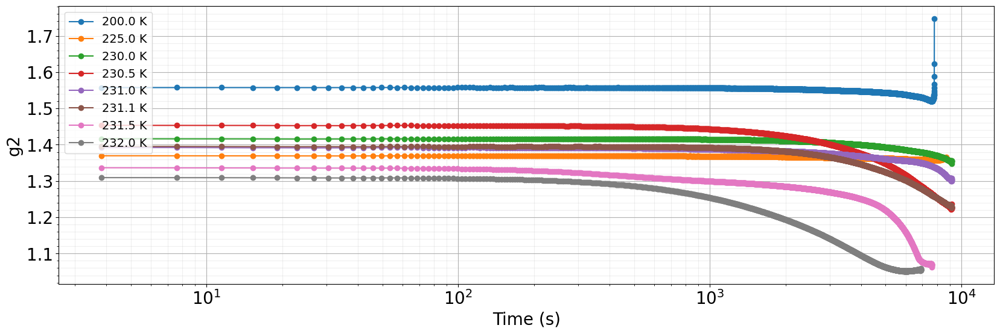

In [6]:
plt.figure(figsize=(20,6))

for k in df:
    plt.semilogx(df[k]['t'][1:], df[k]['g2'][1:], '-o', label=f'{k} K')
    
plt.xlabel('Time (s)')
plt.ylabel('g2')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.legend(fontsize=14)
plt.show()

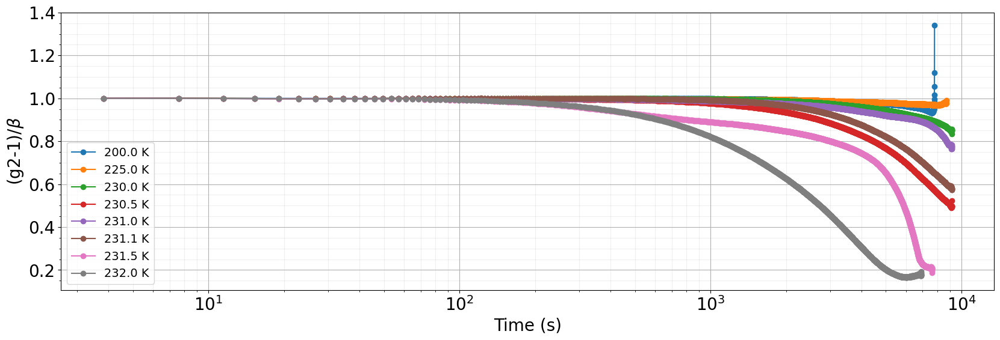

In [402]:
plt.figure(figsize=(20,6))

for k in df:
    g = df[k]['g2'][1:]
    g = g-1
    g/= g[0]
    plt.semilogx(df[k]['t'][1:], g, '-o', label=f'{k} K')
    
plt.xlabel('Time (s)')
plt.ylabel(r'(g2-1)/$\beta$')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.legend(fontsize=14)
plt.show()

In [380]:
df.head()

,200.0,225.0,230.0,230.5,231.0,231.1,231.5,232.0
I0,"[3924074.5, 5675856.0, 5671510.5, 5719870.0, 5...","[3436363.7561540604, 3625005.777390003, 388993...","[6596746.483584166, 6573964.37879324, 6542131....","[3829644.7268309593, 3839438.74177742, 3840476...","[1851387.1065443754, 1849650.1932754517, 18672...","[1804151.4403164387, 1820951.8153731823, 17832...","[2956280.0248761177, 2946470.594007015, 297166...","[2807824.0790686607, 2860997.395802498, 287575..."
g2,"[2.244013122776648, 1.5574586923595717, 1.5575...","[1.9199913861887374, 1.369571172635046, 1.3695...","[1.8984451944312113, 1.4163879078394195, 1.416...","[2.040900499375456, 1.453415404792756, 1.45330...","[2.0537401321341813, 1.3922161649837475, 1.392...","[2.216482396290602, 1.3951367314132774, 1.3952...","[1.7744139933320238, 1.3365103287597728, 1.336...","[1.6679695561276866, 1.3093275431007174, 1.309..."
integrated_image,"[[-22026.025, -20226.578, -8356.113, 12845.396...","[[57822.01762664318, 55705.651694357395, 24963...","[[31704.166274368763, 37104.23644399643, 32896...","[[14708.630834106356, 17510.742964223027, 3598...","[[46993.372248232365, -9222.360726714134, -987...","[[-21909.132342219353, 5848.169311136007, -517...","[[17892.246096409857, 20469.520103096962, 3865...","[[65718.35486984253, 44847.516795158386, 25951..."
label_array,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
t,"[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8...","[0.0, 3.815, 7.63, 11.445, 15.26, 19.075, 22.8..."


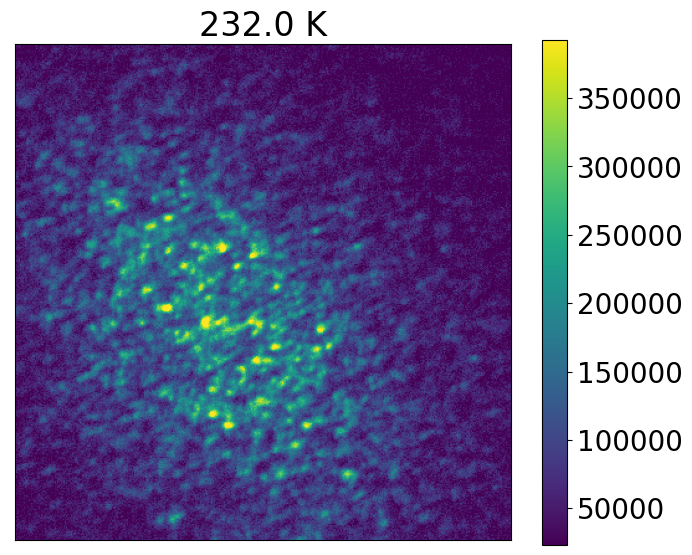

In [392]:
k = 232.0
img = df[k]['integrated_image']

#roi = np.s_[280:680,600:1000]

vmin = np.percentile(img, 10)
vmax = np.percentile(img, 99.9)


plt.figure(figsize=(8,8))
plt.title(f'{k} K')
plt.imshow(img, vmin=vmin, vmax=vmax)
plt.colorbar(shrink=0.82)
plt.xticks([])
plt.yticks([])
plt.show()

In [405]:
tmp = []
for k in df:
    tmp.append(np.sum(df[k]['integrated_image']))

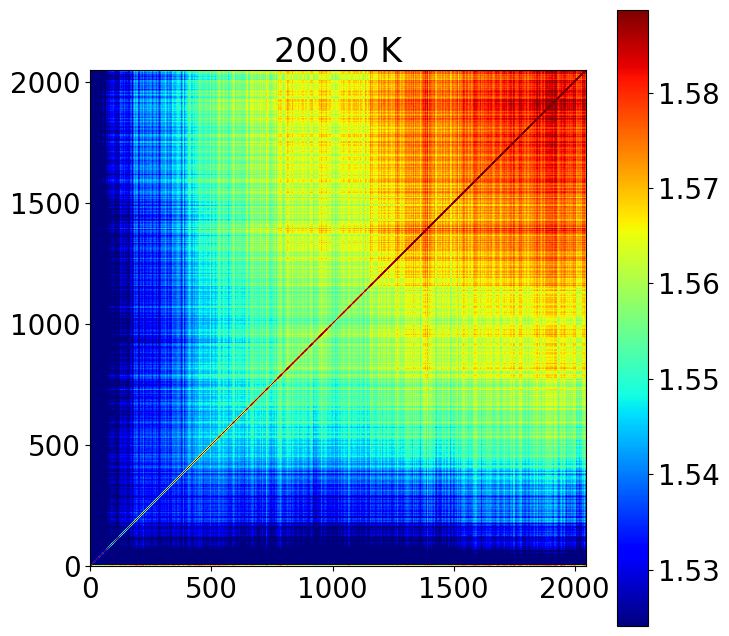

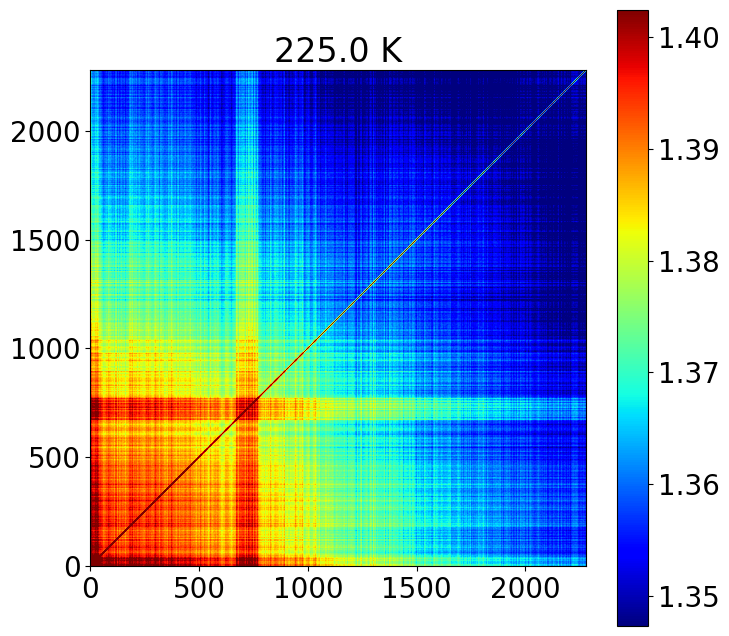

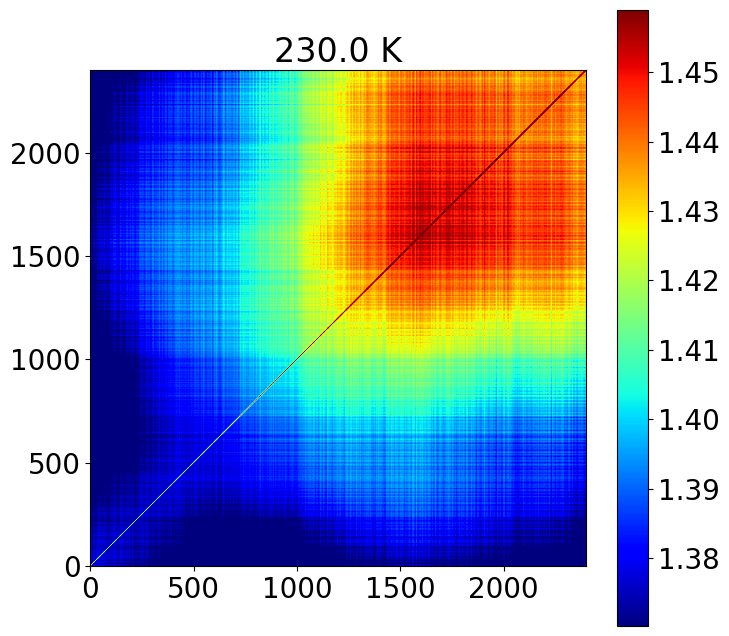

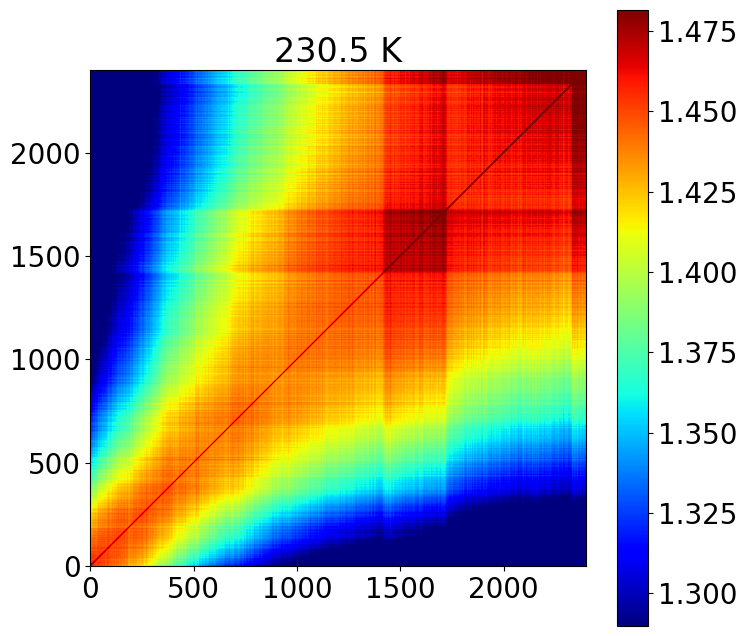

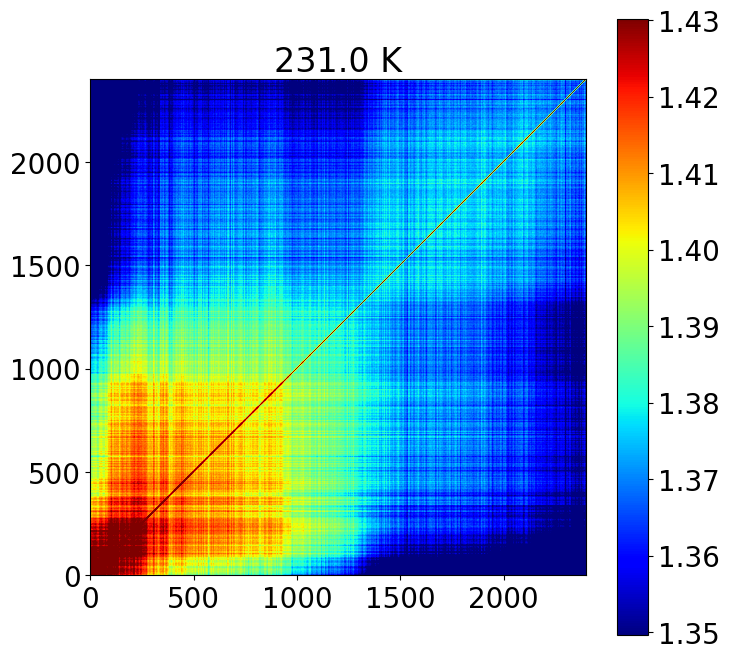

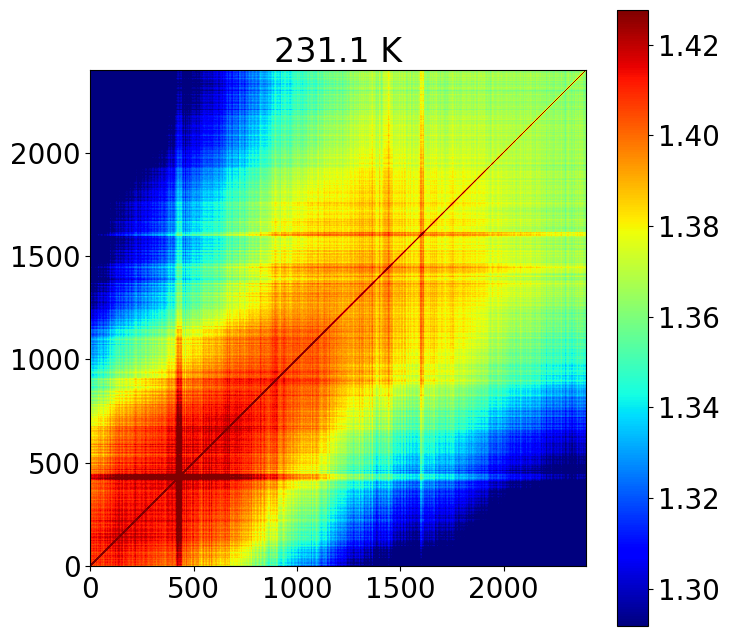

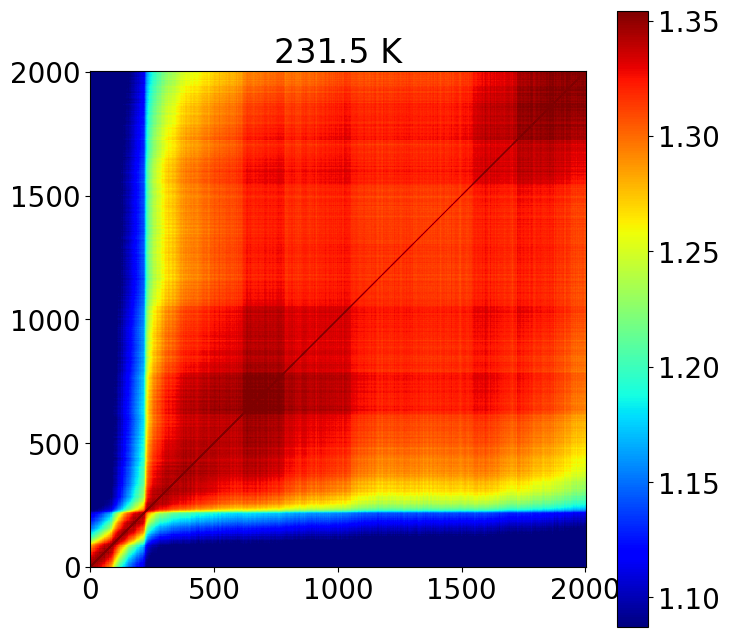

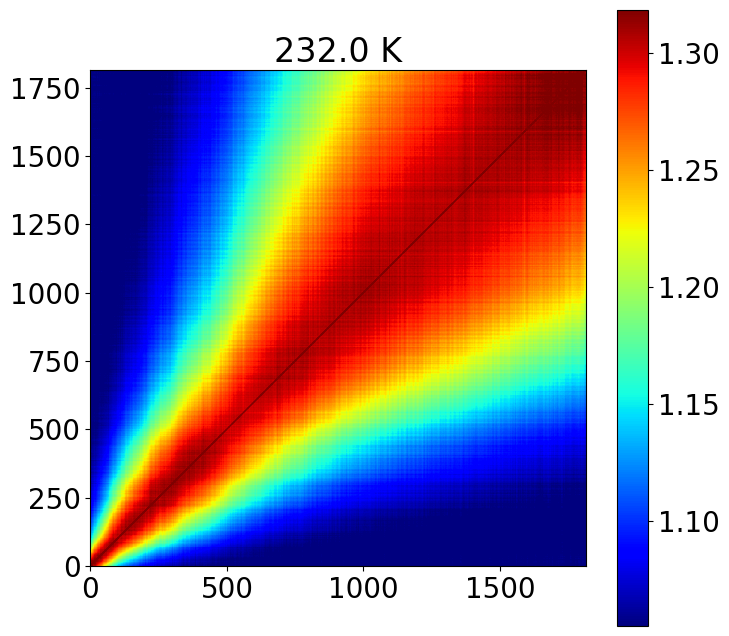

In [411]:
for k in df:
    img = df[k]['two_time']
    vmin = np.percentile(img, 10)
    vmax = np.percentile(img, 99)
    
    
    plt.figure(figsize=(8,8))
    plt.title(f'{k} K')
    plt.imshow(img, origin='lower', cmap='jet',
              vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.show()

In [ ]:
pwd

'C:\\Users\\rtumbleson\\Google Drive\\Shared drives\\code\\notebooks'

In [417]:
np.save('./slowing_two_time.npy', img)

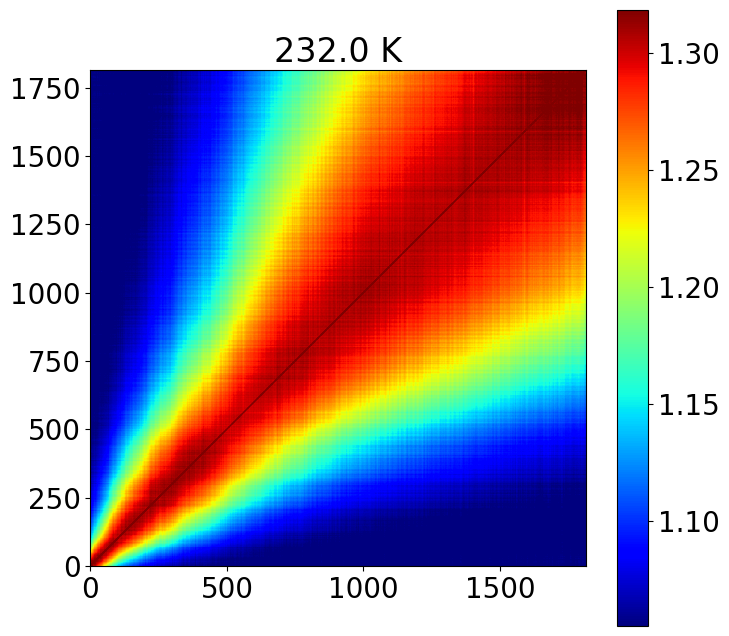

In [ ]:
plt.figure(figsize=(8,8))
plt.title(f'{k} K')
plt.imshow(img, origin='lower', cmap='jet',
          vmin=vmin, vmax=vmax)
plt.colorbar()
plt.show()

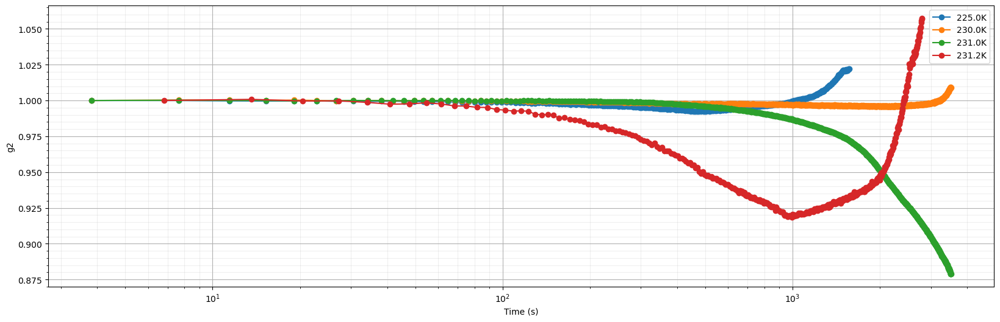

In [599]:
plt.figure(figsize=(20,6))
for k in df:
    g2 = df.unstack()[k]['g2'][1:-100]
    t = df.unstack()[k]['t'][1:-100]
    plt.semilogx(t, g2/g2[0], '-o', label=f'{k}K')
    
plt.xlabel('Time (s)')
plt.ylabel('g2')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.legend()
plt.show()

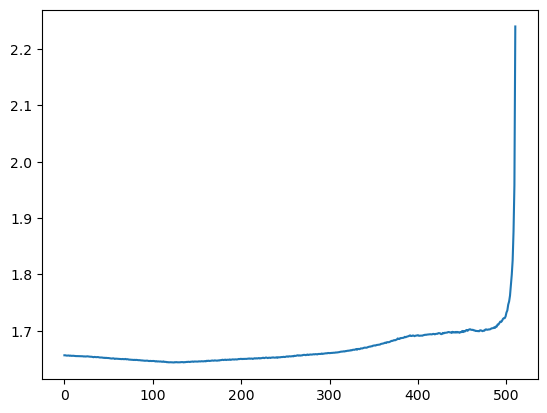

In [594]:
plt.plot(g2)

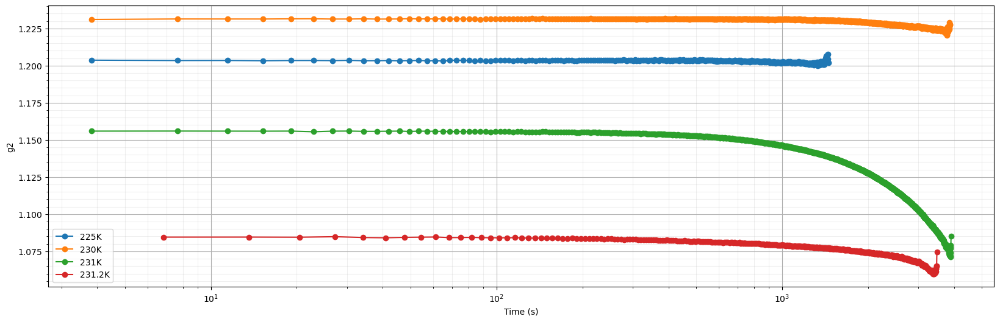

In [918]:
plt.figure(figsize=(20,6))
plt.semilogx(g2s[225]['t'][1:], g2s[225]['g2'][1:], '-o', label='225K')
plt.semilogx(g2s[230]['t'][1:-10], g2s[230]['g2'][1:-10], '-o', label='230K')
plt.semilogx(g2s[231]['t'][1:], g2s[231]['g2'][1:], '-o', label='231K')
plt.semilogx(g2s[231.2]['t'][1:], g2s[231.2]['g2'][1:], '-o', label='231.2K')
plt.xlabel('Time (s)')
plt.ylabel('g2')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.legend()
plt.show()

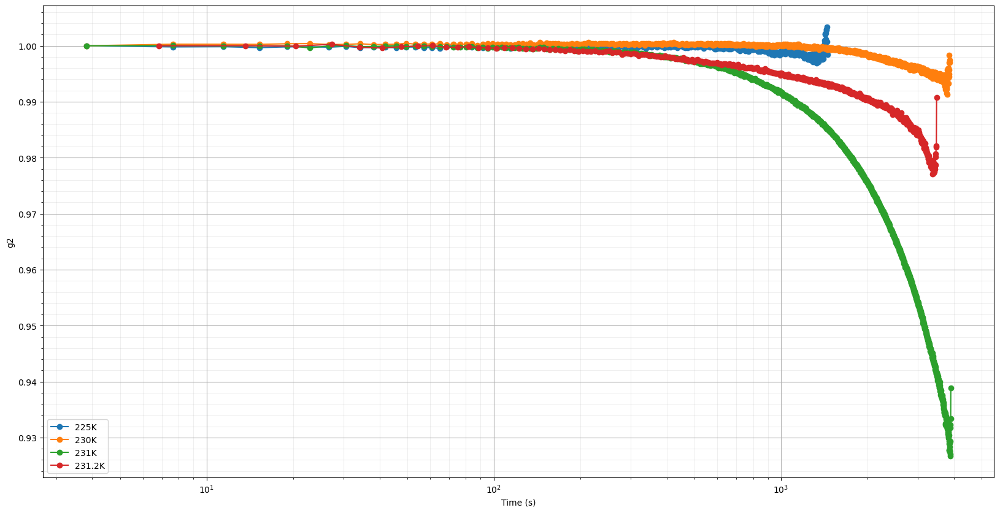

In [919]:
plt.figure(figsize=(20,10))
plt.semilogx(g2s[225]['t'][1:], g2s[225]['g2'][1:]/g2s[225]['g2'][1], '-o', label='225K')
plt.semilogx(g2s[230]['t'][1:-10], g2s[230]['g2'][1:-10]/g2s[230]['g2'][1], '-o', label='230K')
plt.semilogx(g2s[231]['t'][1:], g2s[231]['g2'][1:]/g2s[231]['g2'][1], '-o', label='231K')
plt.semilogx(g2s[231.2]['t'][1:], g2s[231.2]['g2'][1:]/g2s[231.2]['g2'][1], '-o', label='231.2K')
plt.xlabel('Time (s)')
plt.ylabel('g2')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.legend()
plt.show()

# rocking scans

In [19]:
folder = r"G:\.shortcut-targets-by-id\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\Cosmic Scattering Endstation 7.0.1.1\Data\Tumbleson\pcmo_3-17-2023/"
files = sorted(glob(folder+'*'))
files

['G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\100K_energy_scan',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\desktop.ini',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\end_stuff',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\temperature_scan',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\warming_up',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\xpcs']

In [20]:
folder = r"G:\.shortcut-targets-by-id\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\Cosmic Scattering Endstation 7.0.1.1\Data\Tumbleson\pcmo_3-17-2023/temperature_scan/rocking/225K/"
files = sorted(glob(folder+'*'))
for i, f in enumerate(files):
    print(i, basename(f))

0 225K_th=60 2023 March 18 04_53_45 046-raw.spe
1 225K_th=60 2023 March 18 04_53_45 046.spe
2 225K_th=60.2 2023 March 18 04_53_13 045-raw.spe
3 225K_th=60.2 2023 March 18 04_53_13 045.spe
4 225K_th=60.4 2023 March 18 04_52_32 044-raw.spe
5 225K_th=60.4 2023 March 18 04_52_32 044.spe
6 225K_th=60.6 2023 March 18 04_52_05 043-raw.spe
7 225K_th=60.6 2023 March 18 04_52_05 043.spe
8 225K_th=60.8 2023 March 18 04_51_27 042-raw.spe
9 225K_th=60.8 2023 March 18 04_51_27 042.spe
10 225K_th=61 2023 March 18 04_50_22 041-raw.spe
11 225K_th=61 2023 March 18 04_50_22 041.spe
12 225K_th=61.2 2023 March 18 04_49_49 040-raw.spe
13 225K_th=61.2 2023 March 18 04_49_49 040.spe
14 225K_th=61.4 2023 March 18 04_49_25 039-raw.spe
15 225K_th=61.4 2023 March 18 04_49_25 039.spe
16 225K_th=61.6 2023 March 18 04_48_43 038-raw.spe
17 225K_th=61.6 2023 March 18 04_48_43 038.spe
18 225K_th=61.8 2023 March 18 04_48_17 037-raw.spe
19 225K_th=61.8 2023 March 18 04_48_17 037.spe
20 225K_th=62 2023 March 18 04_26_58 0

In [51]:
files = [f for f in files if 'raw' not in f]
files = [f for f in files if 'tif' not in f]
files = files[:-4]

In [58]:
for i, f in enumerate(files):
    print(i, basename(f))

0 225K_th=60 2023 March 18 04_53_45 046.spe
1 225K_th=60.2 2023 March 18 04_53_13 045.spe
2 225K_th=60.4 2023 March 18 04_52_32 044.spe
3 225K_th=60.6 2023 March 18 04_52_05 043.spe
4 225K_th=60.8 2023 March 18 04_51_27 042.spe
5 225K_th=61 2023 March 18 04_50_22 041.spe
6 225K_th=61.2 2023 March 18 04_49_49 040.spe
7 225K_th=61.4 2023 March 18 04_49_25 039.spe
8 225K_th=61.6 2023 March 18 04_48_43 038.spe
9 225K_th=61.8 2023 March 18 04_48_17 037.spe
10 225K_th=62 2023 March 18 04_26_58 023.spe
11 225K_th=62 2023 March 18 04_47_34 036.spe
12 225K_th=62 2023 March 18 04_55_55 047.spe
13 225K_th=62.2 2023 March 18 04_27_33 024.spe
14 225K_th=62.2 2023 March 18 04_31_03 025.spe
15 225K_th=62.4 2023 March 18 04_31_59 026.spe
16 225K_th=62.6 2023 March 18 04_32_34 027.spe
17 225K_th=62.8 2023 March 18 04_36_52 029.spe
18 225K_th=63 2023 March 18 04_37_41 030.spe
19 225K_th=63.2 2023 March 18 04_44_25 031.spe
20 225K_th=63.4 2023 March 18 04_45_01 032.spe
21 225K_th=63.6 2023 March 18 04_45

In [82]:
th = []
for f in files:
    b = basename(f)
    tmp = re.findall("\d+\.\d+", basename(f))
    if len(tmp) == 0:
        th.append(float(re.findall("\d+", basename(f))[1]))
    else:
        th.append(float(tmp[0]))

In [59]:
spe_files = sl.load_from_files(files)

XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
XML Footer was not loaded prior to calling _get_wavelength or 
XML Footer does not contain Wavelength Mapping information
XML Footer was not loade

In [63]:
len(spe_files)

24

In [84]:
len(th)

24

In [66]:
data = np.squeeze([s.data[1] for s in spe_files])

In [67]:
data.shape

(24, 1340, 1300)

In [100]:
from scipy.ndimage.filters import maximum_filter
from scipy.ndimage.morphology import generate_binary_structure, binary_erosion


neighborhood = generate_binary_structure(2,2)
local_max = maximum_filter(img, size=20)==img
background = (img==0)
eroded_background = binary_erosion(background, structure=neighborhood, border_value=1)
detected_peaks = local_max ^ eroded_background

In [101]:
detected_peaks

array([[False, False, False, ..., False,  True, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

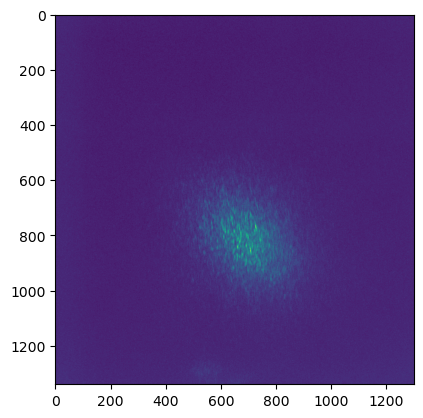

In [102]:
plt.imshow(img)

In [177]:
rois = [np.s_[600:1000, 500:900],
        np.s_[600:1000, 500:900],
        np.s_[500:900, 500:900],
        np.s_[300:900, 500:900],
        np.s_[200:800, 300:1000],
        np.s_[600:1200, 300:1000],
        np.s_[600:1200, 300:1000],
        np.s_[500:1100, 300:1000],
        np.s_[400:1000, 300:1000],
        np.s_[300:1000, 300:1100],
        np.s_[300:1000, 300:1100],
        np.s_[600:1100, 350:1050],
        np.s_[600:1100, 350:850],
        np.s_[350:900, 400:1000],
        np.s_[350:900, 400:1000],
        np.s_[350:800, 400:900],
        np.s_[300:700, 400:900],
        np.s_[200:600, 400:900],
        np.s_[100:500, 500:850],
        np.s_[600:900, 500:850],
        np.s_[500:800, 450:850],
        np.s_[400:700, 500:800],
        np.s_[400:600, 500:800],
        np.s_[200:500, 500:860]
]

0


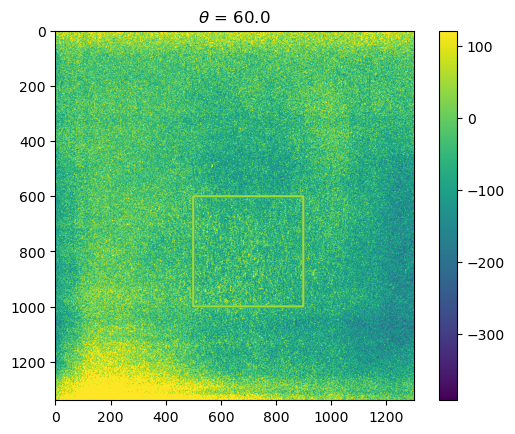

1


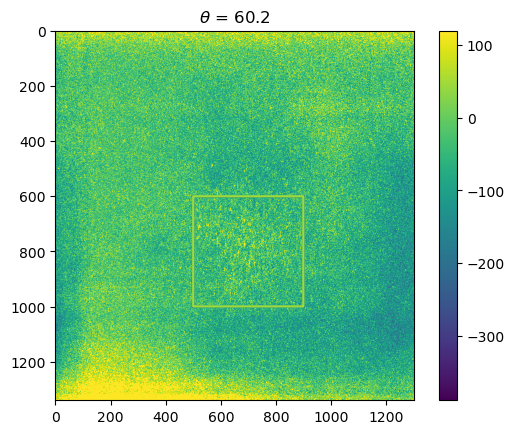

2


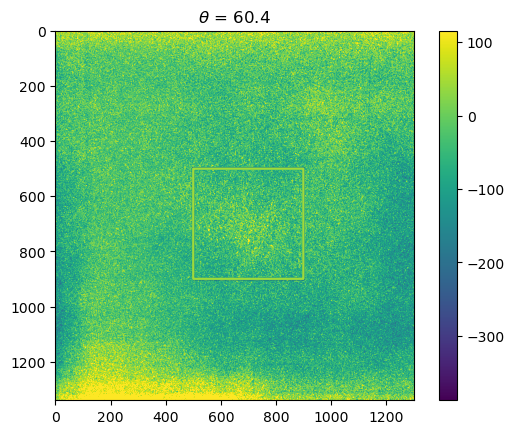

3


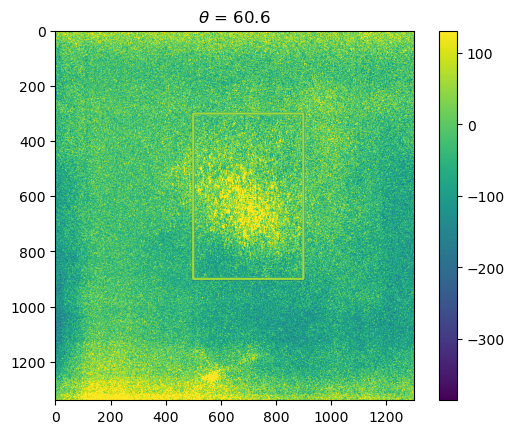

4


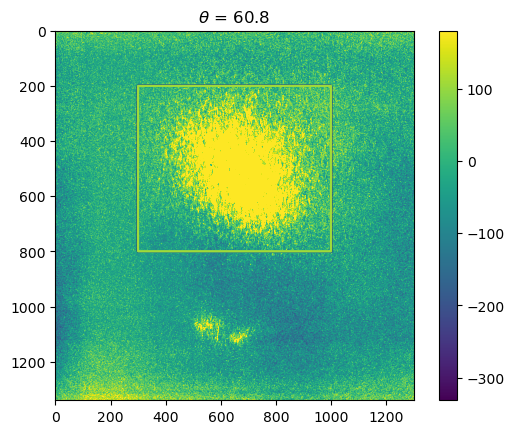

5


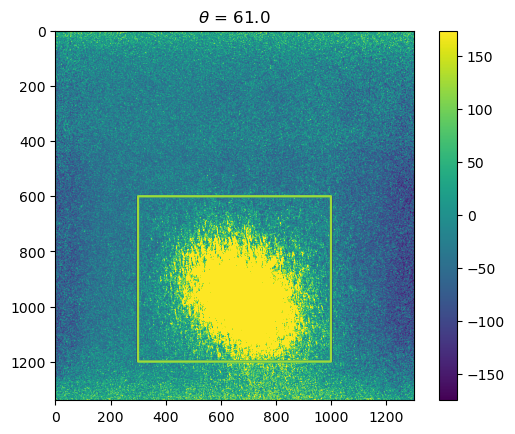

6


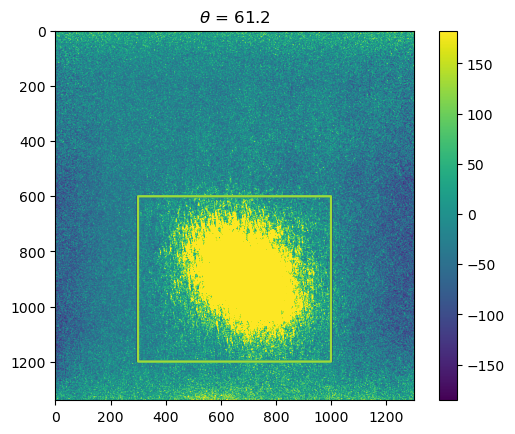

7


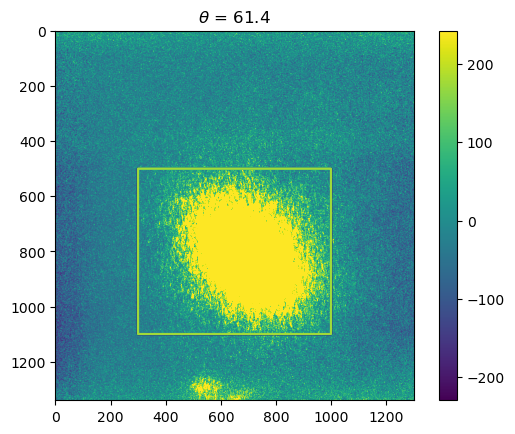

8


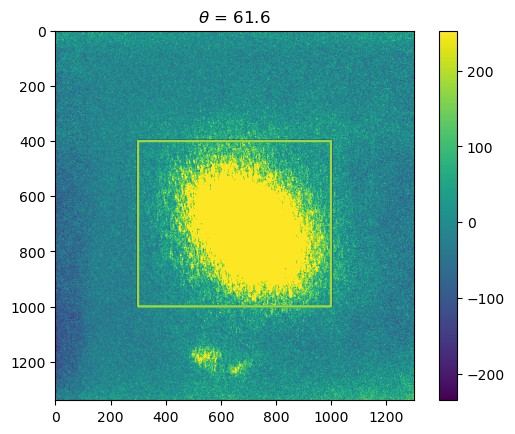

9


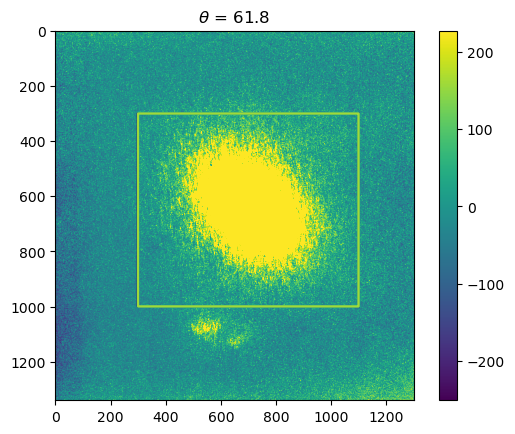

10


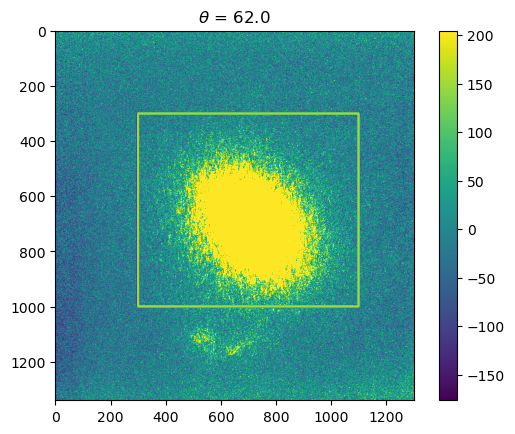

11


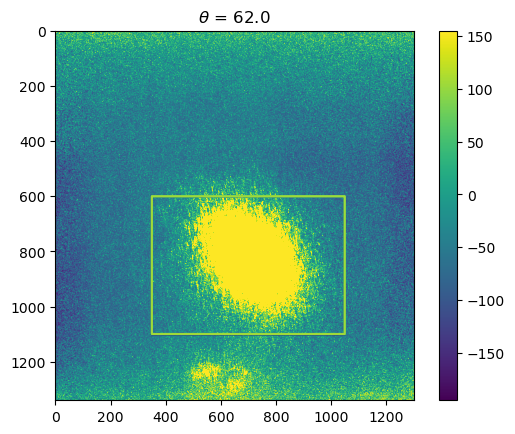

12


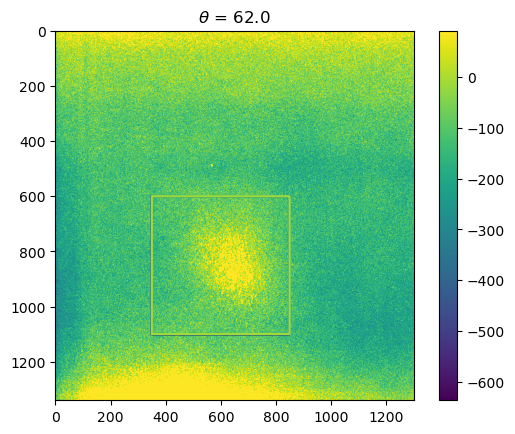

13


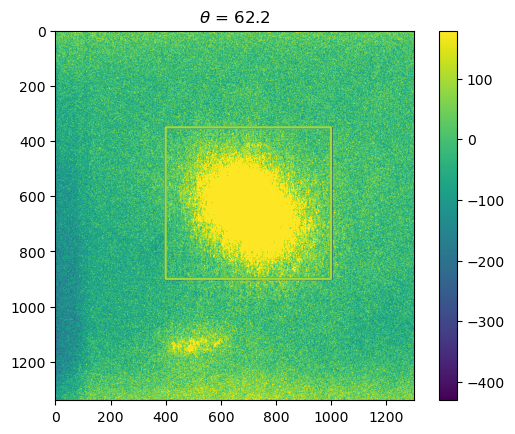

14


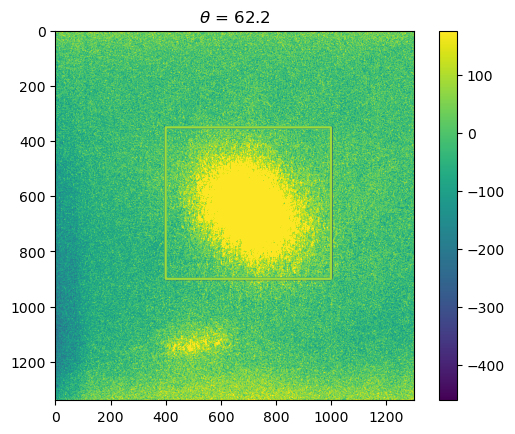

15


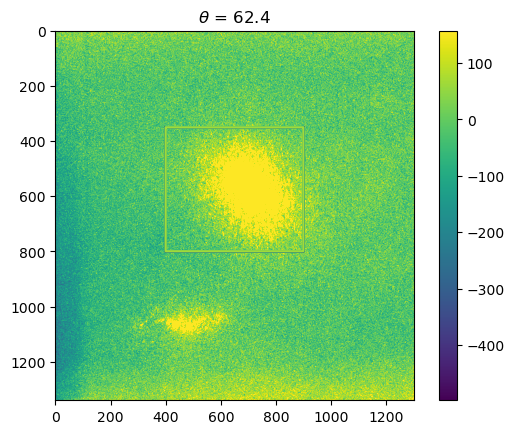

16


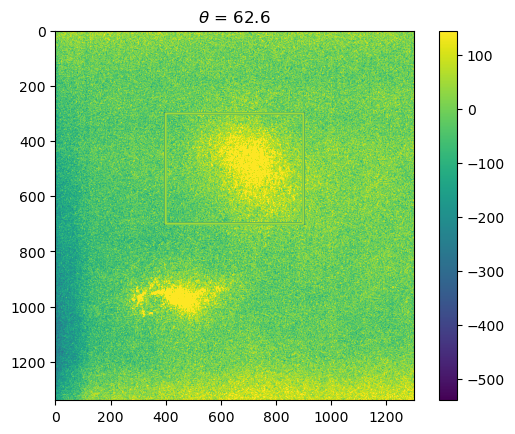

17


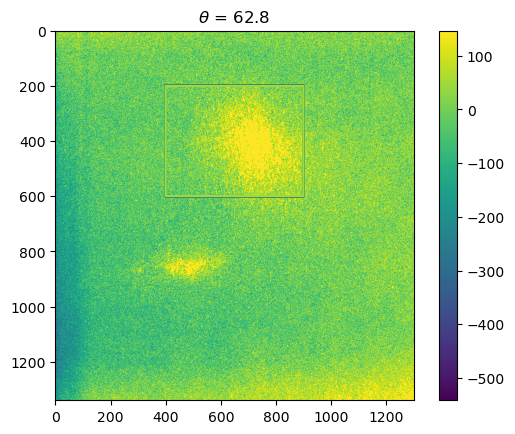

18


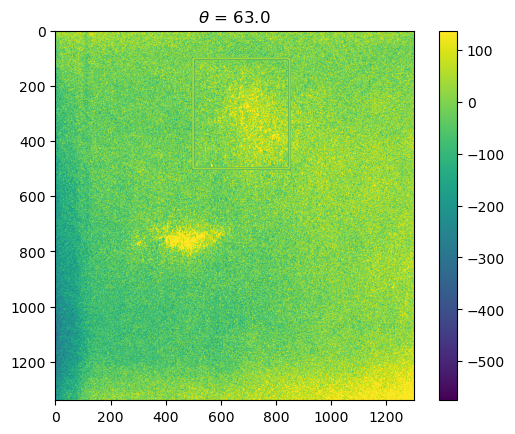

19


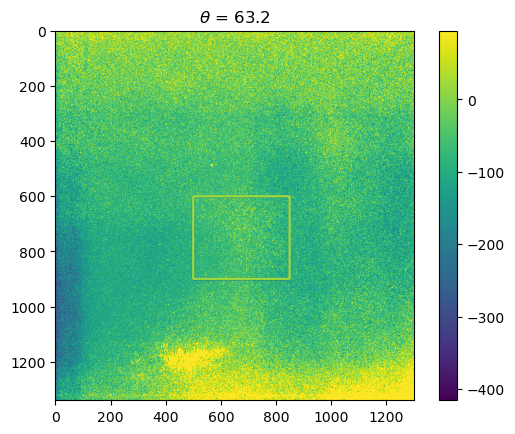

20


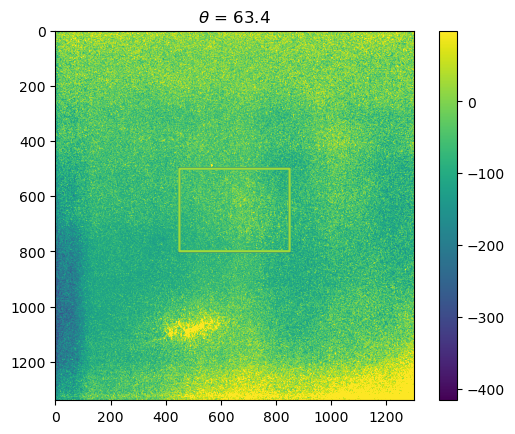

21


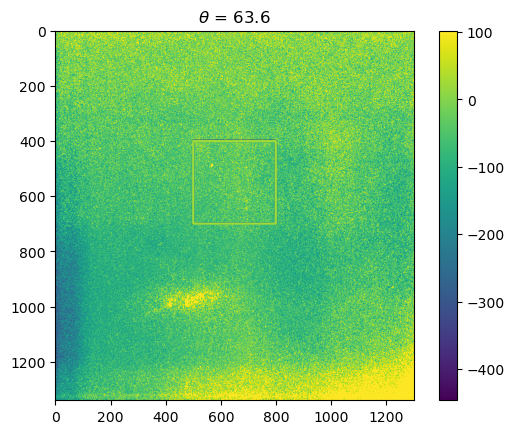

22


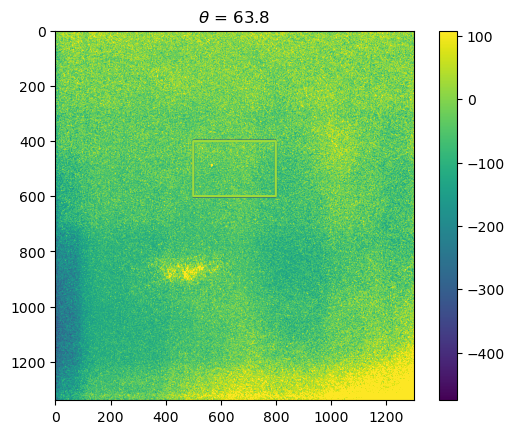

23


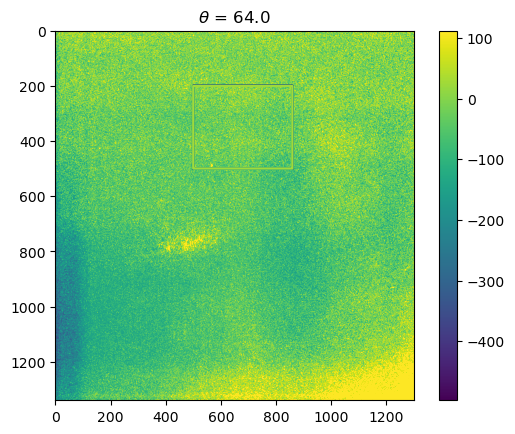

In [179]:
intensity = []
for i, (t, d, roi) in enumerate(zip(th, data, rois)):
    print(i)
    img = lbs.subtract_tilted_background(d)
    img = remove_noise(img)
    
    intensity.append(np.mean(img[roi]))
    con = np.zeros_like(img)
    con[roi] = 1
    
    plt.figure()
    plt.imshow(img, vmax=np.percentile(img, 90))
    plt.colorbar()
    plt.contour(con)
    plt.title(rf'$\theta$ = {t}')
    plt.show()

In [199]:
del intensity[11:13]
del th[11:13]

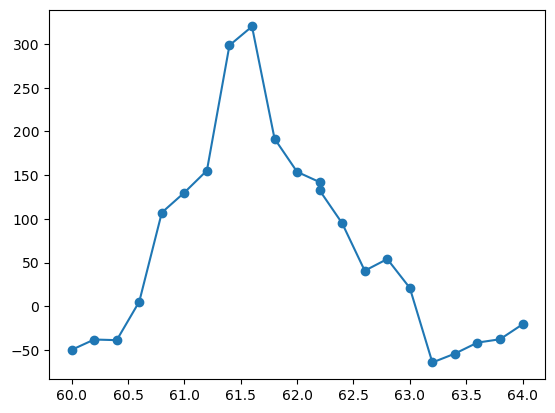

In [200]:
plt.plot(th, intensity, '-o')

# Temperature scan

In [213]:
folder = r"G:\.shortcut-targets-by-id\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\Cosmic Scattering Endstation 7.0.1.1\Data\Tumbleson\pcmo_3-17-2023/"
files = sorted(glob(folder+'*'))
files

['G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\100K_energy_scan',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\desktop.ini',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\end_stuff',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\temperature_scan',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\warming_up',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\xpcs']

In [214]:
folder = r"G:\.shortcut-targets-by-id\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\Cosmic Scattering Endstation 7.0.1.1\Data\Tumbleson\pcmo_3-17-2023/temperature_scan/"
files = sorted(glob(folder+'*.tif'))
for i, f in enumerate(files):
    print(i, basename(f))

0 100K 2023 March 17 22_03_44 000.tif
1 120K 2023 March 17 22_39_28 001.tif
2 140K 2023 March 17 23_07_38 002.tif
3 160K 2023 March 17 23_38_45 003.tif
4 165K 2023 March 17 23_58_40 004.tif
5 167K 2023 March 18 00_17_30 005.tif
6 168K 2023 March 18 00_31_30 006.tif
7 169K 2023 March 18 00_45_55 007.tif
8 170K 2023 March 18 01_00_27 008.tif
9 171K 2023 March 18 01_15_05 009.tif
10 172K 2023 March 18 01_28_32 010.tif
11 173K 2023 March 18 01_43_09 011.tif
12 175K 2023 March 18 01_57_04 012.tif
13 178K 2023 March 18 02_11_53 013.tif
14 180K 2023 March 18 02_31_07 014.tif
15 190K 2023 March 18 02_54_28 015.tif
16 200K 2023 March 18 03_17_49 016.tif
17 210K 2023 March 18 03_38_52 017.tif
18 220K 2023 March 18 04_00_39 018.tif
19 225K 2023 March 18 04_19_52 019.tif
20 227K 2023 March 18 05_39_47 050.tif
21 228K 2023 March 18 06_12_45 076.tif
22 229K 2023 March 18 06_25_02 077.tif
23 230K 2023 March 18 06_51_31 101.tif
24 230_5K 2023 March 18 07_29_34 129.tif
25 231K 2023 March 18 07_46_39 13

In [228]:
temps = []
for f in files:
    b = basename(f)
    tmp = re.findall("\d+", basename(f))
    if tmp[1] != '2023':
        temps.append(float(tmp[0]+'.'+tmp[1]))
    else:
        temps.append(float(tmp[0]))

In [223]:
data = np.array([np.sum(io.imread(f), axis=0) for f in tqdm(files)])

  0%|          | 0/36 [00:00<?, ?it/s]

In [239]:
from lmfit.lineshapes import lorentzian
def lorentzian2d(x, y, amplitude=1., centerx=0., centery=0., sigmax=1., sigmay=1.,
                 rotation=0):
    """Return a two dimensional lorentzian.

    The maximum of the peak occurs at ``centerx`` and ``centery``
    with widths ``sigmax`` and ``sigmay`` in the x and y directions
    respectively. The peak can be rotated by choosing the value of ``rotation``
    in radians.
    """
    xp = (x - centerx)*np.cos(rotation) - (y - centery)*np.sin(rotation)
    yp = (x - centerx)*np.sin(rotation) + (y - centery)*np.cos(rotation)
    R = (xp/sigmax)**2 + (yp/sigmay)**2

    return 2*amplitude*lorentzian(R)/(np.pi*sigmax*sigmay)

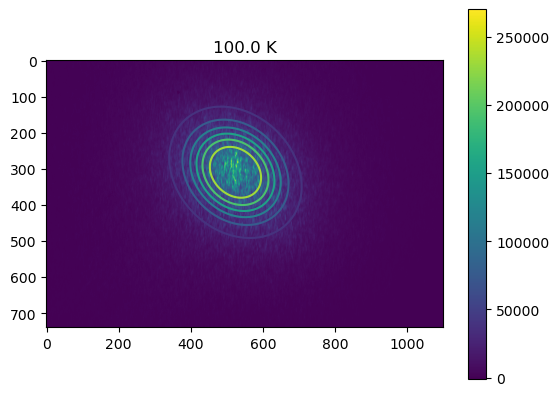

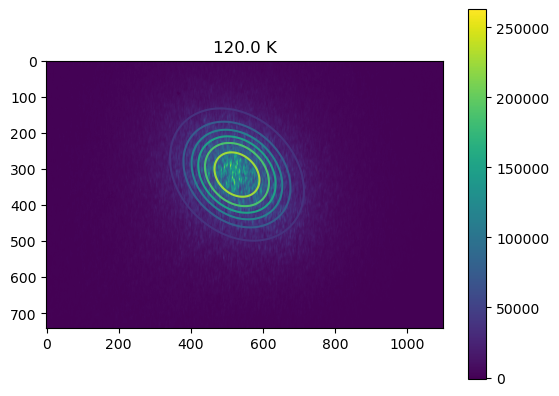

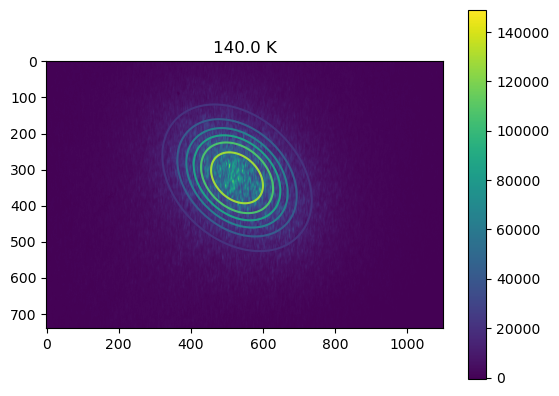

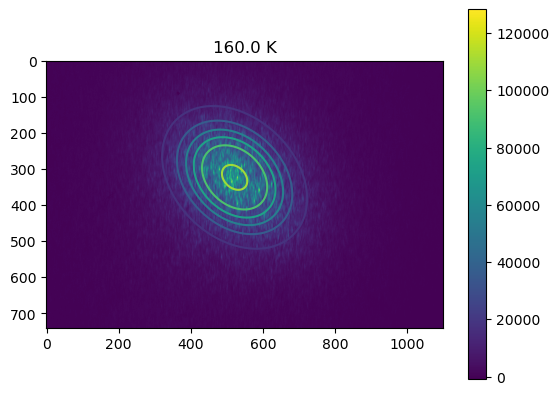

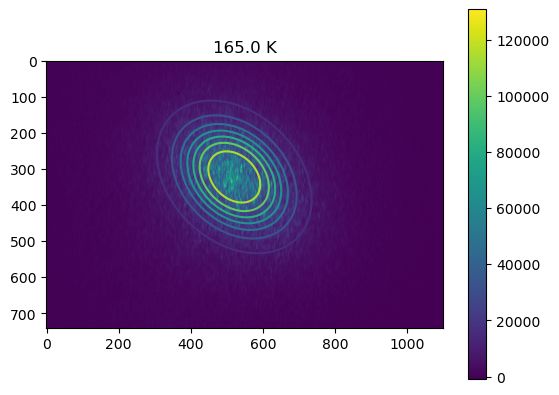

...

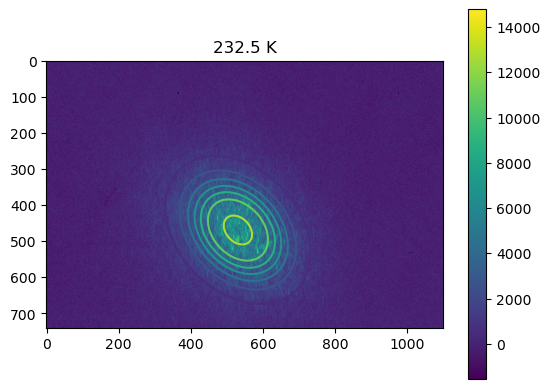

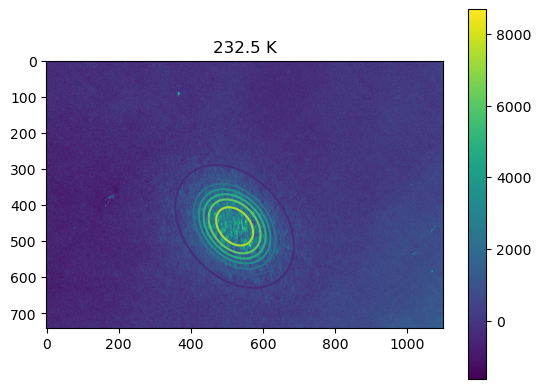

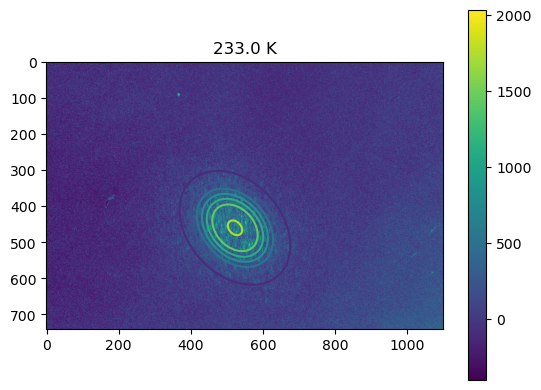

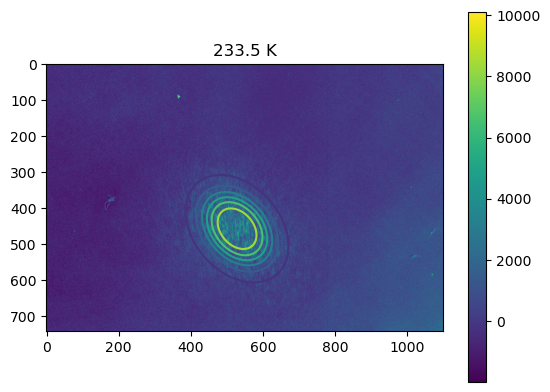

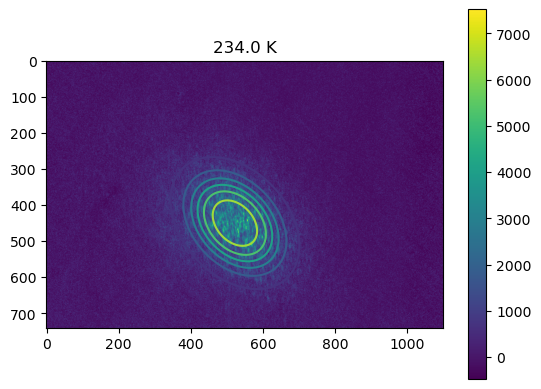

In [246]:
intensity = []
results = []
for i, (temp, d) in enumerate(zip(temps, data)):
    if temp > 234:
        continue
    img = lbs.subtract_tilted_background(d[:-200, 200:])
    img = remove_noise(img)
    
    img = img[400:, :]
    
    intensity.append(np.sum(img))
    
    
    x, y = np.indices(img.shape)
    mod = Model(lorentzian2d, independent_vars=['x','y'])
    params = mod.make_params(amplitude=20000, centerx=500, centery=500)
    params['rotation'].set(value=.1, min=0, max=np.pi/2)
    params['sigmax'].set(value=100, min=50)
    params['sigmay'].set(value=100, min=50)
    
    out = mod.fit(img, x=x, y=y, params=params)
    fit = mod.func(x, y, **out.best_values)
    results.append(out)
    
    
    
    plt.figure()
    plt.imshow(img)
    plt.colorbar()
    plt.title(f'{temp} K')
    plt.contour(fit)
    plt.show()

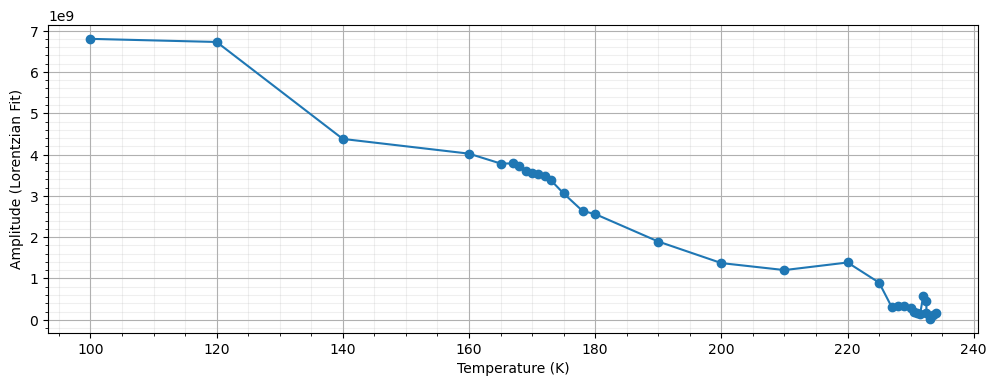

In [274]:
amp = np.array([r.best_values['amplitude'] for r in results])
amp_err = np.array([r.params['amplitude'].stderr for r in results])


fig, ax = plt.subplots(figsize=(12,4))
plt.errorbar(temps[:33], amp, yerr=amp_err, fmt='-o')
plt.ylabel('Amplitude (Lorentzian Fit)')
plt.xlabel('Temperature (K)')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.show()

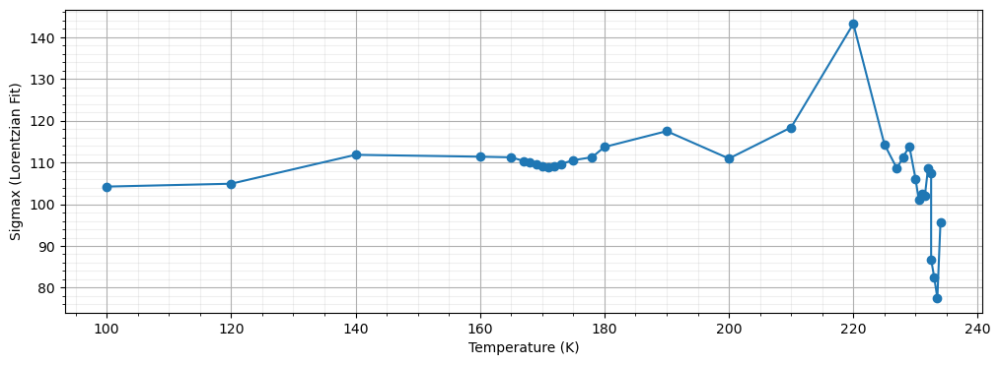

In [275]:
sigmax = np.array([r.best_values['sigmax'] for r in results])
sigmax_err = np.array([r.params['sigmax'].stderr for r in results])

fig, ax = plt.subplots(figsize=(12,4))
plt.errorbar(temps[:33], sigmax, yerr=sigmax_err, fmt='-o')
plt.ylabel('Sigmax (Lorentzian Fit)')
plt.xlabel('Temperature (K)')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.show()

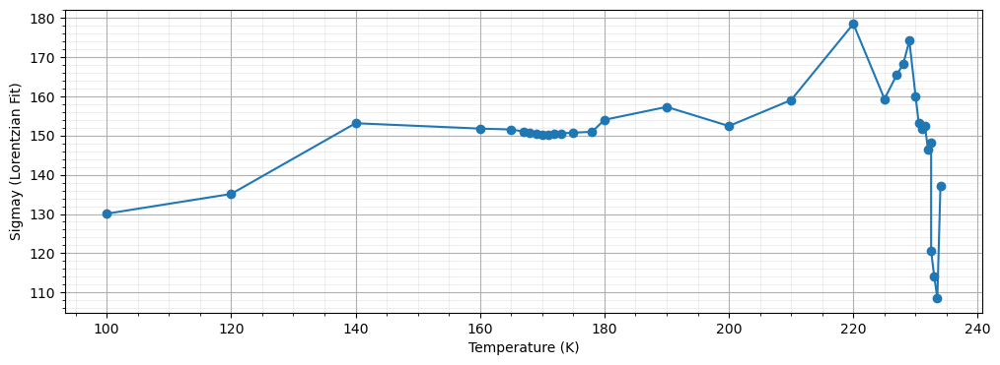

In [276]:
sigmay = np.array([r.best_values['sigmay'] for r in results])
sigmay_err = np.array([r.params['sigmay'].stderr for r in results])

fig, ax = plt.subplots(figsize=(12,4))
plt.errorbar(temps[:33], sigmay, yerr=sigmay_err, fmt='-o')
plt.ylabel('Sigmay (Lorentzian Fit)')
plt.xlabel('Temperature (K)')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.show()

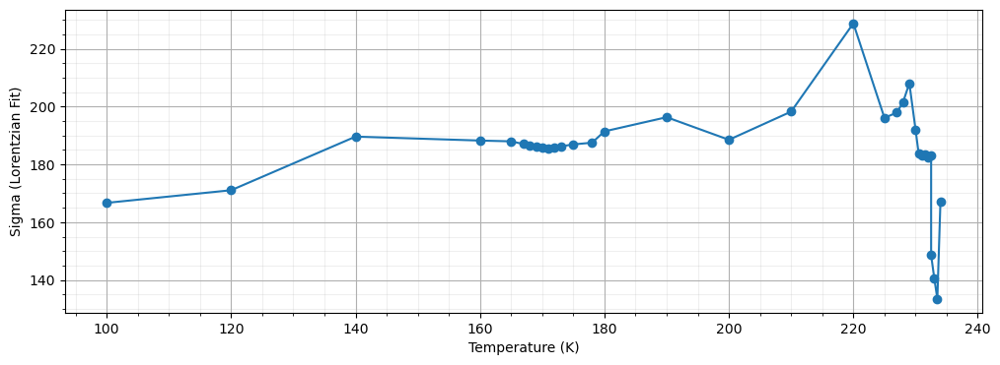

In [278]:
sigma = np.array([np.sqrt(sx**2 + sy**2) for (sx, sy) in zip(sigmax, sigmay)])


fig, ax = plt.subplots(figsize=(12,4))
plt.plot(temps[:33], sigma, '-o')
plt.ylabel('Sigma (Lorentzian Fit)')
plt.xlabel('Temperature (K)')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.show()

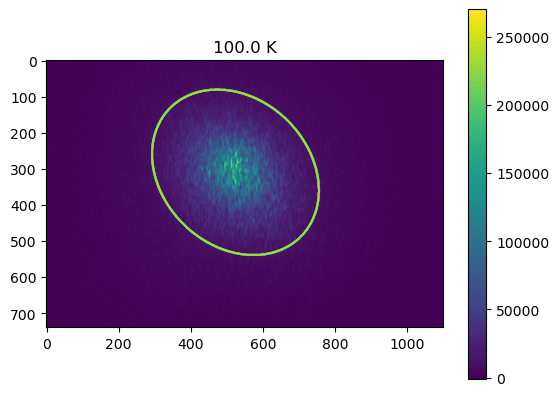

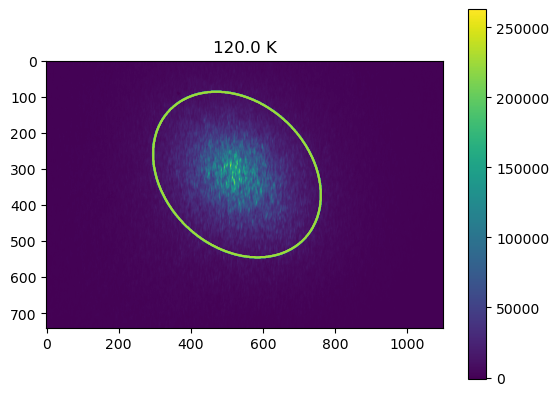

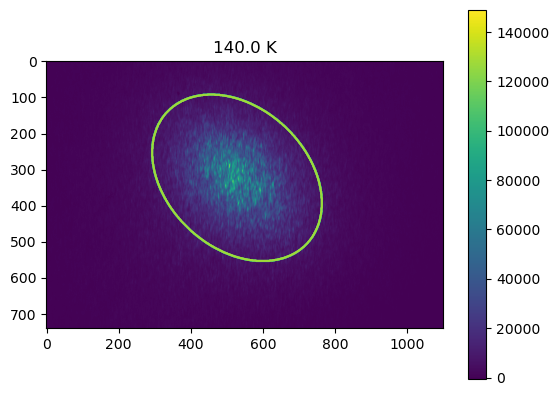

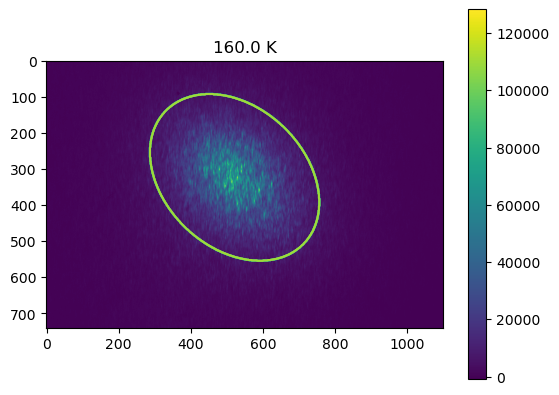

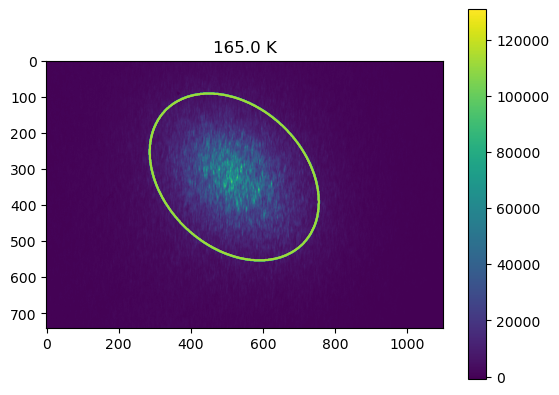

...

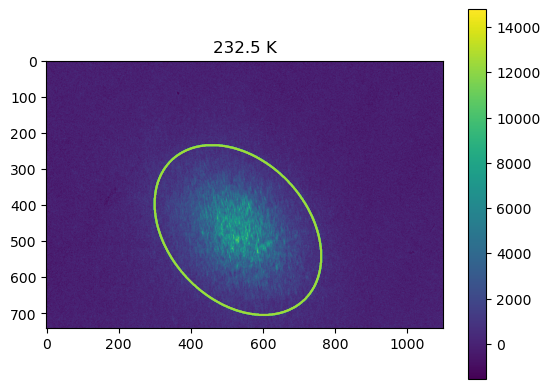

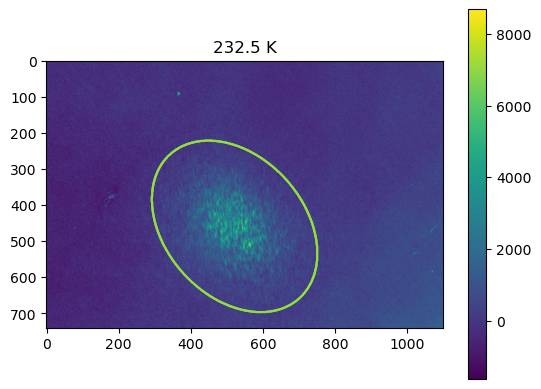

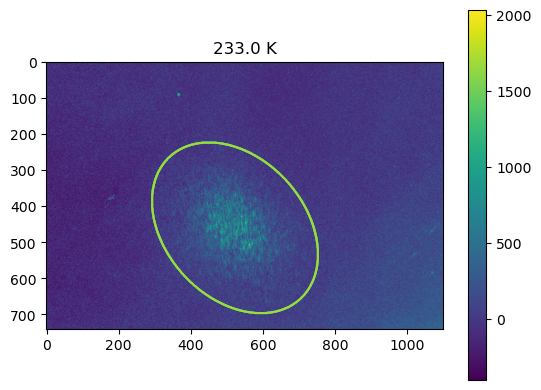

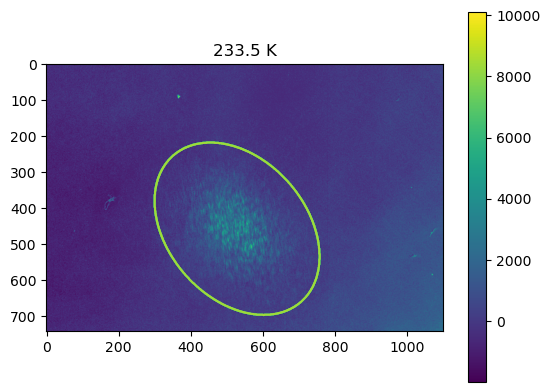

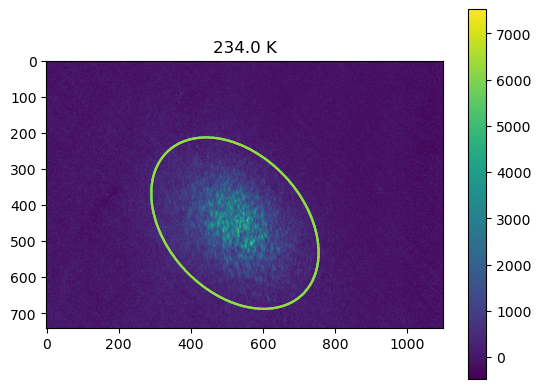

In [283]:
avg = []
integrated = []

bkgd = []
for i, (temp, d, out) in enumerate(zip(temps, data, results)):
    if temp > 234:
        continue
    img = lbs.subtract_tilted_background(d[:-200, 200:])
    img = remove_noise(img)
    
    img = img[400:, :]

    fit = mod.func(x, y, **out.best_values)
    mask = np.ones_like(fit)
    mask[fit<np.percentile(fit, 80)] = 0
    avg.append(np.mean(img[mask!=0]))
    integrated.append(np.sum(img[mask!=0]))
    
    bkgd.append(np.mean(img[:200, :200]))
    
    plt.figure()
    plt.imshow(img)
    plt.colorbar()
    plt.title(f'{temp} K')
    plt.contour(mask)
    plt.show()

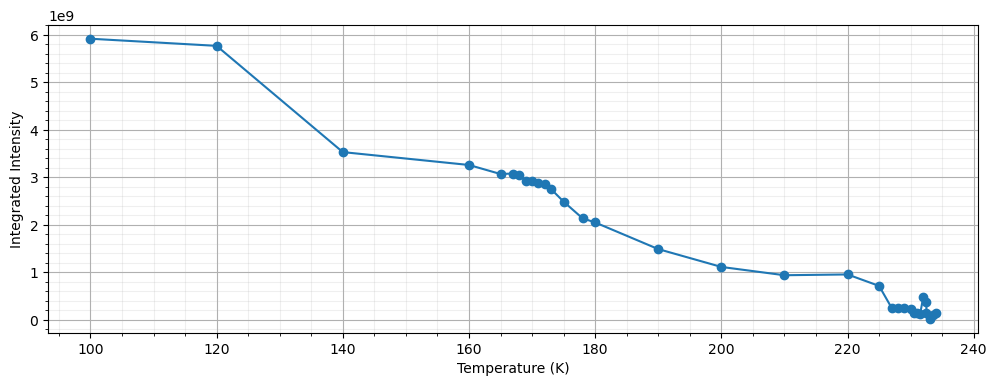

In [282]:
fig, ax = plt.subplots(figsize=(12,4))
plt.plot(temps[:33], integrated, '-o')
plt.ylabel('Integrated Intensity')
plt.xlabel('Temperature (K)')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.show()

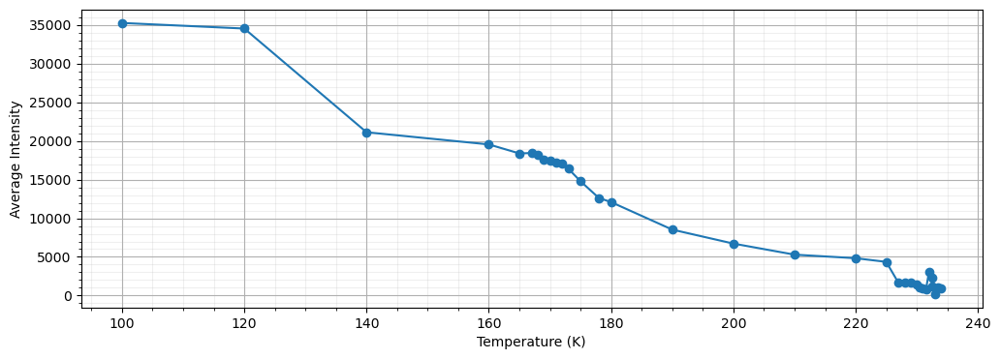

In [286]:
fig, ax = plt.subplots(figsize=(12,4))
plt.plot(temps[:33], np.array(avg)-np.array(bkgd), '-o')
plt.ylabel('Average Intensity')
plt.xlabel('Temperature (K)')
plt.minorticks_on()
plt.grid(which='major')
plt.grid(which='minor', alpha=0.2)
plt.show()

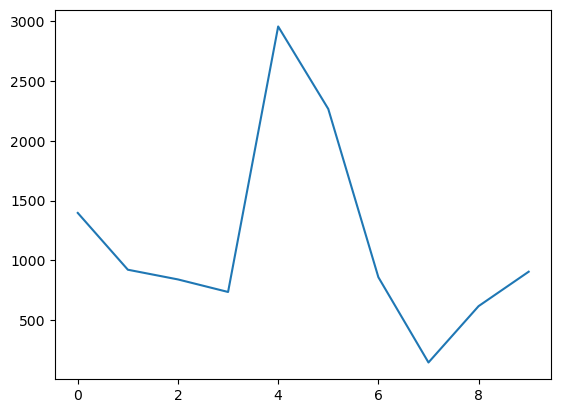

In [289]:
plt.plot(avg[-10:])

In [290]:
temps[:33][-5]

232.5

In [336]:
tmp = results[0]

In [339]:
del tmp.best_values['amplitude_error']

In [341]:
tmp.best_values

{'amplitude': 6801236286.711017,
 'centerx': 309.4523369926061,
 'centery': 523.7654533986075,
 'sigmax': 104.22069745104525,
 'sigmay': 130.08014628888174,
 'rotation': 0.7674693115582745}

In [343]:
results[0].best_values

{'amplitude': 6801236286.711017,
 'centerx': 309.4523369926061,
 'centery': 523.7654533986075,
 'sigmax': 104.22069745104525,
 'sigmay': 130.08014628888174,
 'rotation': 0.7674693115582745}

In [344]:
save_dict = dict()
for (r, temp, d, integ, av) in zip(results, temps, data, integrated, avg):
    img = lbs.subtract_tilted_background(d[:-200, 200:])
    img = remove_noise(img)
    img = img[400:, :]
    
    
    
    fit = mod.func(x, y, **r.best_values)
    mask = np.ones_like(fit)
    mask[fit<np.percentile(fit, 80)] = 0
    
    save_dict[temp] = dict()
    save_dict[temp]['image'] = img
    save_dict[temp]['integrated_intensity'] = integ
    save_dict[temp]['average_intensity'] = av
    save_dict[temp]['mask'] = mask
    
    for par in r.params:
        save_dict[temp][par] = r.params[par].value
        save_dict[temp][par+'_error'] = r.params[par].stderr

In [346]:
import pandas as pd

df = pd.DataFrame(save_dict)

# Energy Scan

In [2]:
folder = r"G:\.shortcut-targets-by-id\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\Cosmic Scattering Endstation 7.0.1.1\Data\Tumbleson\pcmo_3-17-2023/"
files = sorted(glob(folder+'*'))
files

['G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\100K_energy_scan',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\end_stuff',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\pcmo_3-23-2023',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\temperature_scan',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\warming_up',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\pcmo_3-17-2023\\xpcs']

In [4]:
folder = r"G:\.shortcut-targets-by-id\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\Cosmic Scattering Endstation 7.0.1.1\Data\Tumbleson\pcmo_3-17-2023/100K_energy_scan/"
files = sorted(glob(folder+'*.tif'))[2:]
for i, f in enumerate(files):
    print(i, basename(f))

0 energy_scan_630eV 2023 March 17 21_10_35 000.tif
1 energy_scan_635eV 2023 March 17 21_12_01 001.tif
2 energy_scan_636eV 2023 March 17 21_12_26 002.tif
3 energy_scan_637eV 2023 March 17 21_12_52 003.tif
4 energy_scan_638eV 2023 March 17 21_13_09 004.tif
5 energy_scan_639eV 2023 March 17 21_13_30 005.tif
6 energy_scan_640eV 2023 March 17 21_13_49 006.tif
7 energy_scan_641eV 2023 March 17 21_14_12 007.tif
8 energy_scan_642eV 2023 March 17 21_14_34 008.tif
9 energy_scan_643eV 2023 March 17 21_14_59 009.tif
10 energy_scan_644eV 2023 March 17 21_15_23 010.tif
11 energy_scan_645eV 2023 March 17 21_15_41 011.tif
12 energy_scan_646eV 2023 March 17 21_16_00 012.tif
13 energy_scan_647eV 2023 March 17 21_16_17 013.tif
14 energy_scan_648eV 2023 March 17 21_16_36 014.tif
15 energy_scan_649eV 2023 March 17 21_16_55 015.tif
16 energy_scan_650eV 2023 March 17 21_17_21 016.tif
17 energy_scan_651eV 2023 March 17 21_17_48 017.tif
18 energy_scan_652eV 2023 March 17 21_18_12 018.tif
19 energy_scan_653eV 2

In [5]:
energy = []
for f in files:
    b = basename(f)
    tmp = re.findall("\d+", basename(f))
    energy.append(float(tmp[0]))

In [9]:
data = np.array([io.imread(f) for f in tqdm(files)])

  0%|          | 0/33 [00:00<?, ?it/s]

In [10]:
data.shape

(33, 1340, 1300)

In [18]:
roi = np.s_[300:1000, 400:1100]

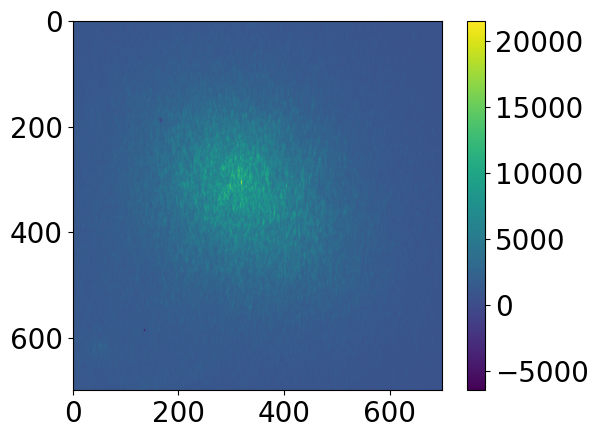

In [19]:
plt.imshow(data[11][roi])
plt.colorbar()

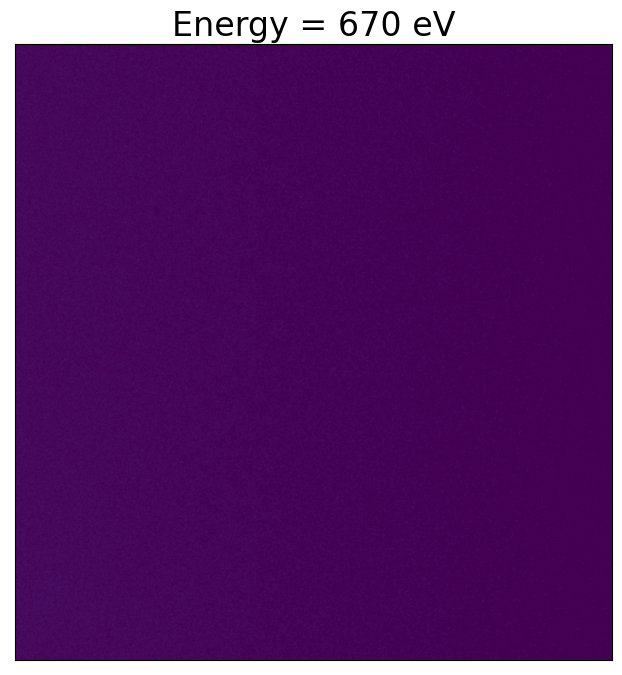

In [26]:
from matplotlib import animation
out_path = 'G:/Shared drives/code/out/pcmo/'


vmax = np.percentile(data[11][roi], 99)
vmin = 0



def animate(i):
    im.set_data(data[i][roi])
    ax.set_title(f'Energy = {energy[i]:.0f} eV')
    return ax, im

fig, ax = plt.subplots(figsize=(8,8))
im = ax.imshow(data[0], vmin=vmin, vmax=vmax)
plt.xticks([])
plt.yticks([])
ani = animation.FuncAnimation(fig, animate, frames=range(len(data)))

#FFwriter = animation.FFMpegWriter(fps=5)
ani.save(out_path + f'energy_scan.mp4')

# old temperature plan

In [47]:
files = sorted(glob(r'G:\.shortcut-targets-by-id\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\Cosmic Scattering Endstation 7.0.1.1\Data\Tumbleson\PCMO/*'))
files

['G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\PCMO_figs',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\PCMO_no_pinhole',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\PCMO_plan_6-26-22',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\desktop.ini',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\optical microscope',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\orientation.pptx',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\theta_t

In [51]:
files = sorted(glob(r'G:\.shortcut-targets-by-id\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\Cosmic Scattering Endstation 7.0.1.1\Data\Tumbleson\PCMO\PCMO_no_pinhole/*'))
files

['G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\PCMO_no_pinhole\\100K_0.1s_06b51048-ede2-4583-a075-8081ed599687.h5',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\PCMO_no_pinhole\\100K_1s_86911e3e-3d6f-47b7-8694-dd0dabe9a56e.h5',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\PCMO_no_pinhole\\100k_1s_0.h5',
 'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\PCMO_no_pinhole\\desktop.ini']

In [40]:
with h5py.File(files[0], 'r') as f:
    data = f['entry']['data']['data'][:]

In [41]:
data.shape

(1000, 960, 2050)

In [44]:
files[0]

'G:\\.shortcut-targets-by-id\\1YpiqDkNOTGtSG67X3m1KkAOsZ3lZoC5i\\Cosmic Scattering Endstation 7.0.1.1\\Data\\Tumbleson\\PCMO\\PCMO_plan_6-26-22\\xpcs_plan_0.h5'

In [43]:
with h5py.File(files[0], 'r') as f:
    print(f['entry']['instrument'].keys())

<KeysViewHDF5 ['NDAttributes', 'detector', 'performance']>
